In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import re


from sklearn.compose import ColumnTransformer

from sklearn.model_selection import train_test_split

from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.pipeline import make_pipeline


import category_encoders as ce


from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import cross_val_score, cross_val_predict
from sklearn.metrics import accuracy_score, precision_score, classification_report, confusion_matrix, recall_score, mean_squared_error
from sklearn.model_selection import ParameterGrid
from sklearn.model_selection import GridSearchCV

from sklearn.linear_model import LogisticRegression
from catboost import CatBoostClassifier, Pool, CatBoostRegressor

from sklearn import metrics
from sklearn.metrics import roc_auc_score, roc_curve
from lightgbm import LGBMClassifier

from collections import Counter

from sklearn.pipeline import Pipeline

from imblearn.over_sampling import SMOTE, RandomOverSampler

import plotly.graph_objects as go
from plotly.subplots import make_subplots
from sklearn.utils import resample



import warnings
warnings.filterwarnings('ignore')
import tqdm

#### Data

In [2]:
df = pd.read_csv('car_loan.csv', decimal=".")

In [3]:
pd.set_option('display.max_columns', None)
df.head()

,Unnamed: 0,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,emp_title,emp_length,home_ownership,annual_inc,verification_status,issue_d,loan_status,pymnt_plan,url,desc,purpose,title,zip_code,addr_state,dti,delinq_2yrs,earliest_cr_line,fico_range_low,fico_range_high,inq_last_6mths,mths_since_last_delinq,mths_since_last_record,open_acc,pub_rec,revol_bal,revol_util,total_acc,initial_list_status,out_prncp,out_prncp_inv,total_pymnt,total_pymnt_inv,total_rec_prncp,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_d,last_pymnt_amnt,next_pymnt_d,last_credit_pull_d,last_fico_range_high,last_fico_range_low,collections_12_mths_ex_med,mths_since_last_major_derog,policy_code,application_type,annual_inc_joint,dti_joint,verification_status_joint,acc_now_delinq,tot_coll_amt,tot_cur_bal,open_acc_6m,open_act_il,open_il_12m,open_il_24m,mths_since_rcnt_il,total_bal_il,il_util,open_rv_12m,open_rv_24m,max_bal_bc,all_util,total_rev_hi_lim,inq_fi,total_cu_tl,inq_last_12m,acc_open_past_24mths,avg_cur_bal,bc_open_to_buy,bc_util,chargeoff_within_12_mths,delinq_amnt,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_recent_bc,mths_since_recent_bc_dlq,mths_since_recent_inq,mths_since_recent_revol_delinq,num_accts_ever_120_pd,num_actv_bc_tl,num_actv_rev_tl,num_bc_sats,num_bc_tl,num_il_tl,num_op_rev_tl,num_rev_accts,num_rev_tl_bal_gt_0,num_sats,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit,revol_bal_joint,sec_app_fico_range_low,sec_app_fico_range_high,sec_app_earliest_cr_line,sec_app_inq_last_6mths,sec_app_mort_acc,sec_app_open_acc,sec_app_revol_util,sec_app_open_act_il,sec_app_num_rev_accts,sec_app_chargeoff_within_12_mths,sec_app_collections_12_mths_ex_med,sec_app_mths_since_last_major_derog,hardship_flag,hardship_type,hardship_reason,hardship_status,deferral_term,hardship_amount,hardship_start_date,hardship_end_date,payment_plan_start_date,hardship_length,hardship_dpd,hardship_loan_status,orig_projected_additional_accrued_interest,hardship_payoff_balance_amount,hardship_last_payment_amount,disbursement_method,debt_settlement_flag,debt_settlement_flag_date,settlement_status,settlement_date,settlement_amount,settlement_percentage,settlement_term
0,83,68376217,NaN,23100.0,23100.0,23100.0,60 months,20.50,618.46,E,E4,Regional Sales Direcdtor,2 years,OWN,110000.0,Not Verified,Dec-2015,Charged Off,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,car,Car financing,197xx,DE,20.43,0.0,Aug-1986,660.0,664.0,0.0,47.0,NaN,11.0,0.0,20594.0,94.9,24.0,w,0.00,0.00,5305.120000,5305.12,1158.07,1868.46,0.0,2278.59,410.1462,Jun-2016,618.46,NaN,Dec-2016,584.0,580.0,0.0,47.0,1.0,Individual,NaN,NaN,NaN,0.0,1105.0,55048.0,1.0,3.0,0.0,0.0,25.0,34454.0,43.0,3.0,5.0,4871.0,54.0,21700.0,3.0,0.0,9.0,5.0,5505.0,1106.0,94.9,0.0,0.0,159.0,352.0,3.0,3.0,2.0,3.0,47.0,0.0,47.0,1.0,5.0,5.0,8.0,11.0,10.0,8.0,12.0,6.0,11.0,0.0,0.0,0.0,3.0,87.5,85.7,0.0,0.0,102524.0,55048.0,21700.0,80824.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Cash,N,NaN,NaN,NaN,NaN,NaN,NaN
1,111,68377006,NaN,6000.0,6000.0,6000.0,36 months,7.91,187.77,A,A5,Road driver,10+ years,MORTGAGE,105000.0,Not Verified,Dec-2015,Fully Paid,n,https://lendingclub.com/browse/loanDetail.acti...,NaN,car,Car financing,431xx,OH,14.45,0.0,May-2006,685.0,689.0,1.0,NaN,16.0,9.0,3.0,8353.0,65.3,11.0,w,0.00,0.00,6753.096795,6753.10,6000.00,753.10,0.0,0.00,0.0000,Jan-2019,187.74,NaN,Feb-2019,649.0,645.0,0.0,NaN,1.0,Individual,NaN,NaN,NaN,0.0,0.0,182893.0,0.0,3.0,0.0,1.0,19.0,32262.0,60.0,0.0,2.0,1503.0,61.0,12800.0,3.0,0.0,1.0,3.0,20321.0,2953.0,51.6,0.0,0.0,103.0,115.0,19.0,19.0,1.0,83.0,NaN,6.0,NaN,0.0,3.0,5.0,3.0,3.0,5.0,5.0,5.0,5.0,9.0,0.0,0.0,0.0,0.0,100.0,0.0,0.0,3.0,225933.0,40615.0,6100.0,540

In [4]:
df.shape

(24013, 152)

In [5]:
df.dtypes

Unnamed: 0                 int64
id                         int64
member_id                float64
loan_amnt                float64
funded_amnt              float64
                          ...   
settlement_status         object
settlement_date           object
settlement_amount        float64
settlement_percentage    float64
settlement_term          float64
Length: 152, dtype: object

In [6]:
recovery_rate = df['total_rec_prncp']/ df['loan_amnt']

recovery_rate = recovery_rate.apply(lambda x: x if x < 1 else 0.3)

In [7]:
#browse notes

In [8]:
browse_notes = ['acc_now_delinq', 'acc_open_past_24mths', 'addr_state', 'all_util',
       'annual_inc', 'application_type', 'avg_cur_bal',
       'chargeoff_within_12_mths', 'collections_12_mths_ex_med', 'delinq_2yrs',
       'delinq_amnt', 'disbursement_method', 'dti', 'emp_length', 'emp_title',
       'fico_range_low', 'home_ownership', 'il_util', 'initial_list_status',
       'inq_fi', 'inq_last_12m', 'inq_last_6mths', 'loan_amnt', 'max_bal_bc',
       'mo_sin_old_il_acct', 'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op',
       'mo_sin_rcnt_tl', 'mort_acc', 'mths_since_last_delinq',
       'mths_since_last_major_derog', 'mths_since_last_record',
       'mths_since_rcnt_il', 'mths_since_recent_bc', 'mths_since_recent_inq',
       'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_bc_sats', 'num_bc_tl',
       'num_il_tl', 'num_tl_120dpd_2m', 'num_tl_30dpd', 'num_tl_90g_dpd_24m',
       'num_tl_op_past_12m', 'open_acc', 'open_acc_6m', 'open_act_il',
       'open_il_12m', 'open_il_24m', 'pct_tl_nvr_dlq', 'pub_rec',
       'pub_rec_bankruptcies', 'revol_bal', 'revol_util', 'tax_liens', 'term',
       'tot_coll_amt', 'tot_cur_bal', 'total_acc', 'total_bal_ex_mort',
       'total_bc_limit', 'total_cu_tl', 'verification_status', 'loan_status']

In [9]:


# Keep only the columns present in browse_notes
df = df[browse_notes]


In [10]:
df.shape

(24013, 64)

In [11]:
#target

In [12]:
df['loan_status'].value_counts()

Fully Paid                                             12444
Current                                                 9064
Charged Off                                             2141
Late (31-120 days)                                       192
In Grace Period                                           75
Does not meet the credit policy. Status:Fully Paid        51
Late (16-30 days)                                         30
Does not meet the credit policy. Status:Charged Off       13
Default                                                    3
Name: loan_status, dtype: int64

In [13]:
df=df[df['loan_status'].isin(['Fully Paid', 
                              'Charged Off'])]
df['TARGET'] = 0
df.loc[df['loan_status'].isin(['Charged Off']), 'TARGET'] = 1

# Verify 'TARGET' value counts
df['TARGET'].value_counts()

0    12444
1     2141
Name: TARGET, dtype: int64

In [14]:
df.drop('loan_status',axis=1,inplace=True)

In [15]:
#anomaly detection

In [16]:
df['emp_length'].head(5)

0      2 years
1    10+ years
2       1 year
3    10+ years
5    10+ years
Name: emp_length, dtype: object

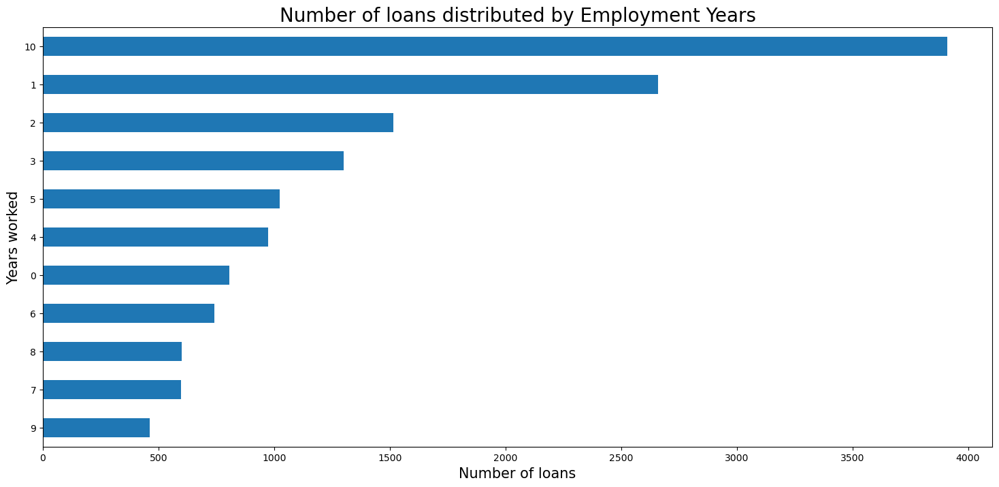

In [17]:
df['emp_length'].fillna(value=0,inplace=True)

df['emp_length'].replace(to_replace='[^0-9]+', value='', inplace=True, regex=True)
df['emp_length'] = df['emp_length'].astype('int')

df['emp_length'].value_counts().sort_values().plot(kind='barh',figsize=(18,8))
plt.title('Number of loans distributed by Employment Years',fontsize=20)
plt.xlabel('Number of loans',fontsize=15)
plt.ylabel('Years worked',fontsize=15);

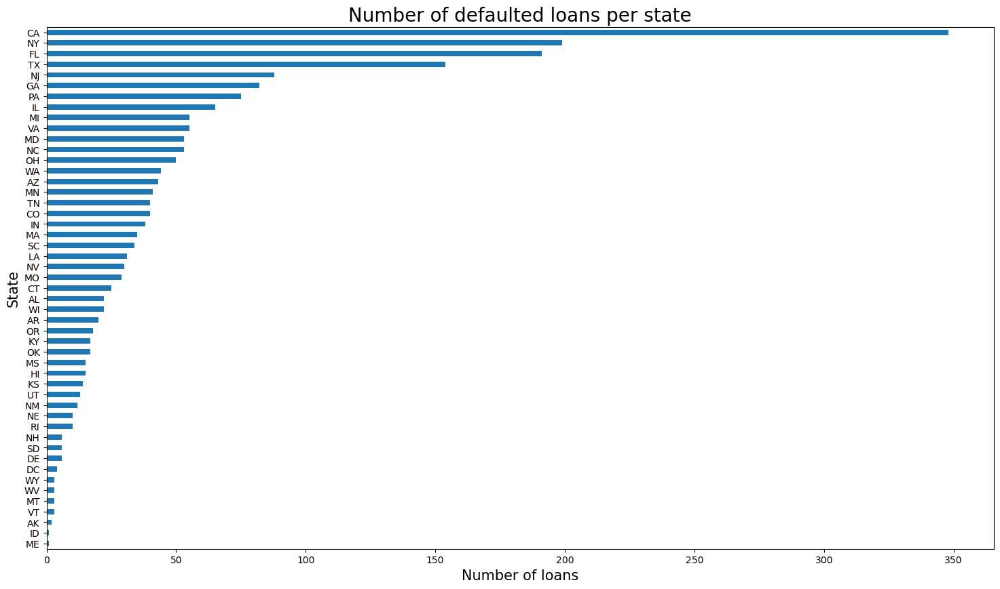

In [18]:
fig = plt.figure(figsize=(18,10))
df[df['TARGET']==1].groupby('addr_state')['TARGET'].count().sort_values().plot(kind='barh')
plt.ylabel('State',fontsize=15)
plt.xlabel('Number of loans',fontsize=15)
plt.title('Number of defaulted loans per state',fontsize=20);

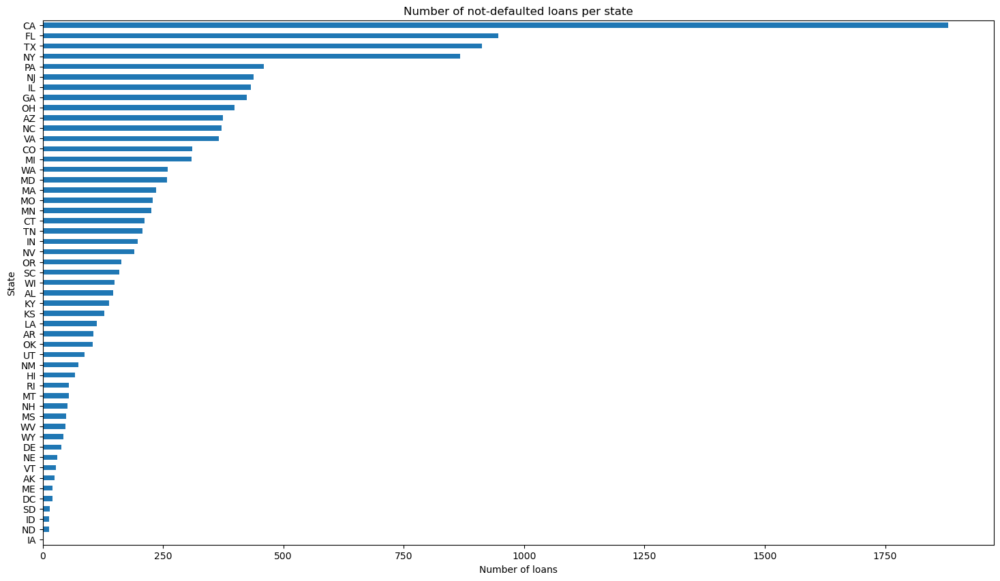

In [19]:
fig = plt.figure(figsize=(18,10))
df[df['TARGET']==0].groupby('addr_state')['TARGET'].count().sort_values().plot(kind='barh')
plt.ylabel('State')
plt.xlabel('Number of loans')
plt.title('Number of not-defaulted loans per state');

In [20]:
corr = df.corr()['TARGET'].sort_values()

# Display correlations
print('Most Positive Correlations:\n', corr.tail(10))
print('\nMost Negative Correlations:\n', corr.head(10))

Most Positive Correlations:
 open_acc_6m             0.048623
inq_last_6mths          0.051009
num_actv_bc_tl          0.072146
num_tl_op_past_12m      0.072904
acc_open_past_24mths    0.074231
all_util                0.088820
dti                     0.091780
revol_util              0.097793
loan_amnt               0.104032
TARGET                  1.000000
Name: TARGET, dtype: float64

Most Negative Correlations:
 fico_range_low          -0.151715
mort_acc                -0.096814
avg_cur_bal             -0.088501
tot_cur_bal             -0.072674
total_bc_limit          -0.068594
mo_sin_old_rev_tl_op    -0.067899
mths_since_recent_bc    -0.061700
mo_sin_rcnt_rev_tl_op   -0.057969
mo_sin_old_il_acct      -0.050646
emp_length              -0.047322
Name: TARGET, dtype: float64


In [21]:
df['application_type'].value_counts()

Individual    14380
Joint App       205
Name: application_type, dtype: int64

In [22]:
df.corr()['annual_inc'].sort_values().tail(10)

max_bal_bc           0.100537
total_acc            0.116773
mort_acc             0.120967
revol_bal            0.121821
total_bc_limit       0.125690
loan_amnt            0.132641
total_bal_ex_mort    0.144207
avg_cur_bal          0.152033
tot_cur_bal          0.198627
annual_inc           1.000000
Name: annual_inc, dtype: float64

In [23]:
#emp_title
# Define the threshold
threshold = 100

# Find the value counts of the 'emp_title'
value_counts = df['emp_title'].value_counts()

# Identify the values to replace
to_replace = value_counts[value_counts < threshold].index

# Replace the values in 'emp_title'
df['emp_title'].replace(to_replace, 'Other', inplace=True)


In [24]:
# df['emp_title'].value_counts().head(30)

In [25]:
#encode term
# remove the ' months' part from the string and convert the result to integer
df['term'] = df['term'].str.replace(' months', '').astype(int)

In [26]:
df

,acc_now_delinq,acc_open_past_24mths,addr_state,all_util,annual_inc,application_type,avg_cur_bal,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,delinq_amnt,disbursement_method,dti,emp_length,emp_title,fico_range_low,home_ownership,il_util,initial_list_status,inq_fi,inq_last_12m,inq_last_6mths,loan_amnt,max_bal_bc,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_last_delinq,mths_since_last_major_derog,mths_since_last_record,mths_since_rcnt_il,mths_since_recent_bc,mths_since_recent_inq,num_accts_ever_120_pd,num_actv_bc_tl,num_bc_sats,num_bc_tl,num_il_tl,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,open_acc,open_acc_6m,open_act_il,open_il_12m,open_il_24m,pct_tl_nvr_dlq,pub_rec,pub_rec_bankruptcies,revol_bal,revol_util,tax_liens,term,tot_coll_amt,tot_cur_bal,total_acc,total_bal_ex_mort,total_bc_limit,total_cu_tl,verification_status,TARGET
0,0.0,5.0,DE,54.0,110000.0,Individual,5505.0,0.0,0.0,0.0,0.0,Cash,20.43,2,Other,660.0,OWN,43.0,w,3.0,9.0,0.0,23100.0,4871.0,159.0,352.0,3.0,3.0,2.0,47.0,47.0,NaN,25.0,3.0,0.0,1.0,5.0,8.0,11.0,10.0,0.0,0.0,0.0,3.0,11.0,1.0,3.0,0.0,0.0,87.5,0.0,0.0,20594.0,94.9,0.0,60,1105.0,55048.0,24.0,55048.0,21700.0,0.0,Not Verified,1
1,0.0,3.0,OH,61.0,105000.0,Individual,20321.0,0.0,0.0,0.0,0.0,Cash,14.45,10,Other,685.0,MORTGAGE,60.0,w,3.0,1.0,1.0,6000.0,1503.0,103.0,115.0,19.0,19.0,1.0,NaN,NaN,16.0,19.0,83.0,6.0,0.0,3.0,3.0,3.0,5.0,0.0,0.0,0.0,0.0,9.0,0.0,3.0,0.0,1.0,100.0,3.0,0.0,8353.0,65.3,3.0,36,0.0,182893.0,11.0,40615.0,6100.0,0.0,Not Verified,0
2,0.0,9.0,IL,84.0,97000.0,Individual,15358.0,0.0,0.0,1.0,0.0,Cash,18.93,1,Other,660.0,MORTGAGE,89.0,w,0.0,4.0,1.0,3600.0,1693.0,118.0,120.0,8.0,4.0,2.0,14.0,NaN,81.0,4.0,8.0,4.0,0.0,6.0,6.0,10.0,16.0,0.0,0.0,0.0,5.0,16.0,1.0,7.0,2.0,5.0,93.1,1.0,1.0,7696.0,59.7,0.0,36,0.0,245735.0,30.0,65226.0,7400.0,0.0,Source Verified,0
3,0.0,1.0,NY,69.0,48000.0,Individual,1717.0,0.0,0.0,0.0,0.0,Cash,12.20,10,Other,680.0,RENT,86.0,w,2.0,0.0,0.0,15000.0,2623.0,135.0,310.0,26.0,16.0,0.0,NaN,NaN,95.0,16.0,51.0,17.0,0.0,4.0,5.0,5.0,2.0,0.0,0.0,0.0,0.0,10.0,0.0,1.0,0.0,1.0,100.0,1.0,1.0,8588.0,60.1,0.0,36,0.0,15450.0,11.0,15450.0,6200.0,0.0,Source Verified,0
5,0.0,4.0,MN,56.0,66000.0,Individual,26129.0,0.0,0.0,1.0,0.0,Cash,19.96,10,Other,695.0,MORTGAGE,69.0,w,1.0,8.0,1.0,6000.0,2060.0,159.0,337.0,15.0,5.0,1.0,6.0,NaN,NaN,5.0,89.0,0.0,0.0,3.0,3.0,12.0,8.0,0.0,0.0,0.0,1.0,11.0,1.0,3.0,1.0,2.0,96.3,0.0,0.0,3731.0,23.9,0.0,36,0.0,287417.0,28.0,29190.0,6300.0,1.0,Not Verified,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24003,0.0,2.0,TX,32.0,52000.0,Individual,14211.0,0.0,0.0,0.0,0.0,Cash,11.22,10,Other,815.0,MORTGAGE,64.0,f,1.0,2.0,0.0,6000.0,144.0,224.0,386.0,57.0,5.0,3.0,NaN,NaN,NaN,7.0,57.0,6.0,0.0,1.0,4.0,11.0,7.0,0.0,0.0,0.0,2.0,7.0,1.0,2.0,1.0,1.0,100.0,0.0,0.0,144.0,0.4,0.0,36,0.0,99479.0,23.0,21549.0,34300.0,0.0,Not Verified,0
24005,0.0,2.0,PA,60.0,50000.0,Individual,3570.0,0.0,0.0,0.0,0.0,Cash,22.61,1,Other,660.0,MORTGAGE,60.0,w,0.0,1.0,1.0,8200.0,3635.0,131.0,140.0,3.0,3.0,2.0,NaN,NaN,81.0,18.0,44.0,3.0,0.0,3.0,4.0,6.0,7.0,0.0,0.0,0.0,1.0,12.0,1.0,5.0,0.0,1.0,100.0,1.0,1.0,10697.0,57.8,0.0,36,0.0,39268.0,19.0,39268.0,14600.0,0.0,Verified,0
24010,0.0,6.0,FL,57.0,40641.0,Individual,4064.0,0.0,0.0,0.0,0.0,Cash,23.83,0,NaN,670.0,RENT,78.0,f,1.0,2.0,0.0,12000.0,24.0,138.0,256.0,15.0,5.0,4.0,NaN,NaN,44.0,5.0,15.0,5.0,0.0,1.0,1.0,5.0,7.0,0.0,0.0,0.0,2.0,7.0,1.0,3.0,2.0,3.0,100.0,1.0,1.0,1873.0,11.6,0.0,36,0.0,28447.0,22.0,28447.0,4400.0,1.0,Verified,0
24011,0.0,4.0,NC,74.0,130000.0,Individual,46422.0,0.0,0.0,0.0,0.0,Cash,15.77,3,Other,665.0,MORTGAGE,62.0,f,0.0,1.0,0.0,28000.0,8575.0,141.0,272.0,1.0,1.0,3.0,NaN,NaN,NaN,29.0,14.0,6.0,0.0,7.0,7.0,10.0,3.0,0.0,0.0,0.0,2.0,13.0,2.0,1.0,0.0

In [27]:
# from sklearn.preprocessing import LabelEncoder

# # Initialize the LabelEncoder
# le = LabelEncoder()

# # Fit the encoder to the data
# le.fit(['E4', 'A5', 'B5', 'B2', 'B1', 'B4', 'B3', 'A4', 'D5', 'A2', 'C2', 'C5', 
#         'C4', 'C1', 'A3', 'E2', 'D4', 'A1', 'D1', 'C3', 'D2', 'D3', 'E3', 'E5', 'E1', 
#         'F5', 'F1', 'G2', 'G1', 'F2', 'F3', 'F4', 'G5', 'G3', 'G4'])

# # Create a mapping
# mapping = dict(zip(le.classes_, le.transform(le.classes_)))

# print(mapping)

In [28]:
# df['sub_grade'] = df['sub_grade'].map(mapping)

In [29]:
df['lgd'] = 1 - recovery_rate

#### Train & Test Split

In [30]:
X_train, X_test, y_train, y_test = train_test_split(df.drop('TARGET',axis=1),
                                                    df['TARGET'],
                                                    test_size=0.2,random_state=101)

In [31]:
X_train_lgd = X_train.copy()
X_test_lgd = X_test.copy()
y_train_lgd = y_train.copy()
y_test_lgd = y_test.copy()

#### Data cleaning

In [32]:
percent_missing = X_train.isnull().sum() * 100 / len(X_train)
missing_value_X_train = pd.DataFrame({'column_name': X_train.columns,
                                 'percent_missing': percent_missing})

In [33]:
missing_value_X_train.sort_values('percent_missing', ascending=False)

,column_name,percent_missing
mths_since_last_record,mths_since_last_record,83.913267
mths_since_last_major_derog,mths_since_last_major_derog,75.591361
il_util,il_util,64.235516
mths_since_rcnt_il,mths_since_rcnt_il,58.381899
open_acc_6m,open_acc_6m,56.624957
...,...,...
chargeoff_within_12_mths,chargeoff_within_12_mths,0.000000
application_type,application_type,0.000000
annual_inc,annual_inc,0.000000
addr_state,addr_state,0.000000


In [34]:
to_drop = missing_value_X_train[missing_value_X_train['percent_missing'] >= 90]

In [35]:
to_drop = to_drop['column_name'].to_list()

In [36]:
to_drop

[]

In [37]:
X_train = X_train.drop(columns=to_drop, errors='ignore')

In [38]:
#missing values

In [39]:
categ_columns = list(X_train.select_dtypes(include=['object']).columns)
num_columns = list(X_train.select_dtypes(include=['float64', 'int64']).columns)

In [40]:
X_train[categ_columns] = X_train[categ_columns].fillna('unknown')
X_train[num_columns] = X_train[num_columns].fillna('-99').astype('float32') #-99

In [41]:
percent_missing = X_train.isnull().sum() * 100 / len(X_train)
missing_value_X_train = pd.DataFrame({'column_name': X_train.columns,
                                 'percent_missing': percent_missing})

In [42]:
missing_value_X_train[missing_value_X_train['percent_missing'] > 0]

,column_name,percent_missing


In [43]:
#unqiue values

In [44]:
cols = []
percentages = []

for col in X_train[categ_columns]:
    cols.append(col)
    # Select the column by name and get count of unique values in it
    count = X_train[col].nunique()
    percent = round(X_train[col].nunique() / len(X_train[col]) * 100, 2)
    percentages.append(percent)

In [45]:
dict_perc = {'Columns':cols,'%':percentages}
df_perc = pd.DataFrame(dict_perc)

In [46]:
df_perc.sort_values(by='%', ascending=False)

,Columns,%
0,addr_state,0.43
3,emp_title,0.05
4,home_ownership,0.04
6,verification_status,0.03
1,application_type,0.02
2,disbursement_method,0.02
5,initial_list_status,0.02


In [47]:
# df_perc = df_perc[df_perc['%'] > 70]
# to_drop.extend(list(df_perc['Columns'].values))

In [48]:
loan_linked = ['zip_code', 'grade', 'int_rate', 'issue_d', 'sub_grade', 'fico_range_low']
to_drop.extend(loan_linked)

In [49]:
X_train = X_train.drop(columns=to_drop, errors='ignore')

In [50]:
X_train.head()

,acc_now_delinq,acc_open_past_24mths,addr_state,all_util,annual_inc,application_type,avg_cur_bal,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,delinq_amnt,disbursement_method,dti,emp_length,emp_title,home_ownership,il_util,initial_list_status,inq_fi,inq_last_12m,inq_last_6mths,loan_amnt,max_bal_bc,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_last_delinq,mths_since_last_major_derog,mths_since_last_record,mths_since_rcnt_il,mths_since_recent_bc,mths_since_recent_inq,num_accts_ever_120_pd,num_actv_bc_tl,num_bc_sats,num_bc_tl,num_il_tl,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,open_acc,open_acc_6m,open_act_il,open_il_12m,open_il_24m,pct_tl_nvr_dlq,pub_rec,pub_rec_bankruptcies,revol_bal,revol_util,tax_liens,term,tot_coll_amt,tot_cur_bal,total_acc,total_bal_ex_mort,total_bc_limit,total_cu_tl,verification_status,lgd
23280,0.0,1.0,MD,83.0,16500.0,Individual,2707.0,0.0,0.0,0.0,0.0,Cash,22.33,7.0,Other,RENT,52.0,f,0.0,3.0,0.0,3000.0,4565.0,21.0,288.0,205.0,21.0,0.0,-99.0,-99.0,-99.0,21.0,261.0,0.0,0.0,2.0,2.0,7.0,1.0,0.0,0.0,0.0,0.0,4.0,0.0,1.0,0.0,1.0,100.000000,0.0,0.0,9787.0,88.199997,0.0,36.0,0.0,10828.0,10.0,10828.0,9700.0,0.0,Not Verified,0.7
11071,0.0,3.0,IN,57.0,85000.0,Individual,6293.0,0.0,0.0,0.0,0.0,Cash,19.34,10.0,Other,MORTGAGE,72.0,w,0.0,1.0,1.0,23450.0,7850.0,93.0,92.0,4.0,4.0,1.0,-99.0,-99.0,-99.0,15.0,4.0,4.0,0.0,2.0,4.0,4.0,10.0,0.0,0.0,0.0,1.0,8.0,1.0,3.0,0.0,2.0,100.000000,0.0,0.0,7910.0,27.600000,0.0,36.0,0.0,50340.0,16.0,50340.0,24700.0,0.0,Not Verified,0.7
23379,0.0,3.0,OR,98.0,70000.0,Individual,4461.0,0.0,0.0,0.0,0.0,Cash,25.75,5.0,Other,RENT,112.0,w,1.0,0.0,0.0,4000.0,4801.0,157.0,162.0,18.0,18.0,0.0,71.0,71.0,-99.0,18.0,28.0,21.0,1.0,4.0,5.0,9.0,54.0,0.0,0.0,0.0,0.0,39.0,0.0,6.0,0.0,2.0,95.900002,0.0,0.0,8646.0,28.799999,0.0,36.0,0.0,173966.0,74.0,173966.0,25500.0,0.0,Not Verified,0.7
19415,0.0,6.0,NY,-99.0,57000.0,Individual,2196.0,0.0,0.0,0.0,0.0,Cash,11.14,3.0,Other,RENT,-99.0,f,-99.0,-99.0,1.0,10000.0,-99.0,35.0,60.0,5.0,5.0,0.0,-99.0,-99.0,-99.0,-99.0,15.0,4.0,0.0,3.0,3.0,5.0,5.0,0.0,0.0,0.0,2.0,9.0,-99.0,-99.0,-99.0,-99.0,100.000000,0.0,0.0,5239.0,65.500000,0.0,36.0,0.0,19766.0,13.0,19766.0,5900.0,-99.0,Verified,0.7
8586,0.0,5.0,TN,82.0,80000.0,Individual,18226.0,0.0,0.0,0.0,0.0,Cash,2.67,6.0,Other,RENT,105.0,w,0.0,0.0,0.0,30000.0,2128.0,120.0,148.0,4.0,4.0,3.0,-99.0,-99.0,-99.0,15.0,4.0,14.0,0.0,3.0,7.0,10.0,12.0,0.0,0.0,0.0,3.0,20.0,1.0,9.0,0.0,2.0,100.000000,0.0,0.0,4167.0,15.100000,0.0,60.0,0.0,364523.0,31.0,86564.0,25000.0,3.0,Verified,0.7


In [51]:
X_train.dtypes

acc_now_delinq          float32
acc_open_past_24mths    float32
addr_state               object
all_util                float32
annual_inc              float32
                         ...   
total_bal_ex_mort       float32
total_bc_limit          float32
total_cu_tl             float32
verification_status      object
lgd                     float32
Length: 63, dtype: object

#### Random oversampling

In [52]:
X_train, lgd_train = X_train.drop(['lgd'], axis='columns'), X_train['lgd']

In [53]:
X_test, lgd_test = X_test.drop(['lgd'], axis='columns'), X_test['lgd']

In [54]:
# ros = RandomOverSampler(random_state=42)
# X_train, y_train= ros.fit_resample(X_train, y_train)

#### Test data cleaning

In [55]:
categ_columns = list(X_test.select_dtypes(include=['object']).columns)
num_columns = list(X_test.select_dtypes(include=['float64', 'int64']).columns)


X_test[categ_columns] = X_test[categ_columns].fillna('unknown')
X_test[num_columns] = X_test[num_columns].fillna(X_test[num_columns].max())

In [56]:
X_test = X_test.drop(columns=to_drop, errors='ignore')

#### Model train

In [57]:
cat_cols = list(X_train.select_dtypes(include=['object']).columns)

In [58]:
cat_cols

['addr_state',
 'application_type',
 'disbursement_method',
 'emp_title',
 'home_ownership',
 'initial_list_status',
 'verification_status']

In [59]:
X_train[cat_cols] = X_train[cat_cols].astype(str)
X_test[cat_cols] = X_test[cat_cols].astype(str)

In [60]:
cat_feat_ind = np.where(X_train.dtypes == 'object')[0]

In [61]:
cat_feat_ind_test = np.where(X_test.dtypes == 'object')[0]

In [62]:
X_train.columns

Index(['acc_now_delinq', 'acc_open_past_24mths', 'addr_state', 'all_util',
       'annual_inc', 'application_type', 'avg_cur_bal',
       'chargeoff_within_12_mths', 'collections_12_mths_ex_med', 'delinq_2yrs',
       'delinq_amnt', 'disbursement_method', 'dti', 'emp_length', 'emp_title',
       'home_ownership', 'il_util', 'initial_list_status', 'inq_fi',
       'inq_last_12m', 'inq_last_6mths', 'loan_amnt', 'max_bal_bc',
       'mo_sin_old_il_acct', 'mo_sin_old_rev_tl_op', 'mo_sin_rcnt_rev_tl_op',
       'mo_sin_rcnt_tl', 'mort_acc', 'mths_since_last_delinq',
       'mths_since_last_major_derog', 'mths_since_last_record',
       'mths_since_rcnt_il', 'mths_since_recent_bc', 'mths_since_recent_inq',
       'num_accts_ever_120_pd', 'num_actv_bc_tl', 'num_bc_sats', 'num_bc_tl',
       'num_il_tl', 'num_tl_120dpd_2m', 'num_tl_30dpd', 'num_tl_90g_dpd_24m',
       'num_tl_op_past_12m', 'open_acc', 'open_acc_6m', 'open_act_il',
       'open_il_12m', 'open_il_24m', 'pct_tl_nvr_dlq', 'pub_rec

#### CatBoost

In [64]:
pool_train = Pool(X_train, y_train, cat_features=cat_cols)

pool_test = Pool(X_test, y_test, cat_features=cat_cols)

# Initialize CatBoostClassifier
cat_model = CatBoostClassifier(
    learning_rate=0.1,
    iterations=100,
    border_count=64,
    depth=3,
    l2_leaf_reg=6,
    verbose=False,
    random_state=42
)

# Fit model
cat_model.fit(pool_train, eval_set=pool_test, plot=True)

MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

Accuracy (test): 0.855
Precision (test): 0.647
Recall (test): 0.006
RocAuc (test): 0.736
GINI (test): 0.472



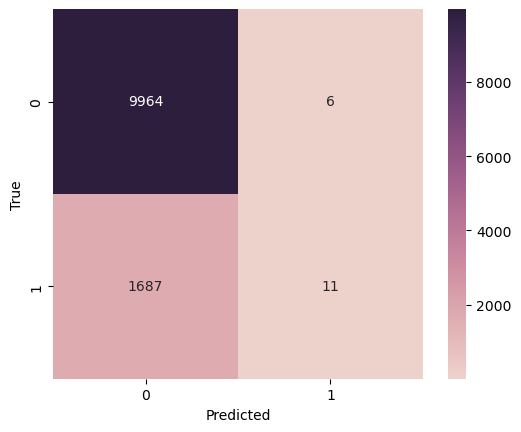

In [157]:
y_pred_train = cat_model.predict(pool_train)
y_pred_proba_train = cat_model.predict_proba(pool_train)[:, 1]

acc_test = accuracy_score(y_train, y_pred_train)
prec_test = precision_score(y_train, y_pred_train)
rec_test = recall_score(y_train, y_pred_train)
roc_auc_test = roc_auc_score(y_train, y_pred_proba_train)
gini_test = 2*roc_auc_test-1
print(f'''Accuracy (test): {acc_test:.3f}
Precision (test): {prec_test:.3f}
Recall (test): {rec_test:.3f}
RocAuc (test): {roc_auc_test:.3f}
GINI (test): {gini_test:.3f}
''')

cm = confusion_matrix(y_train, y_pred_train)
ax = sns.heatmap(cm, cmap=sns.cubehelix_palette(as_cmap=True), annot=True, fmt='d', square=True)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

Accuracy (test): 0.848
Precision (test): 0.533
Recall (test): 0.018
RocAuc (test): 0.692
GINI (test): 0.384



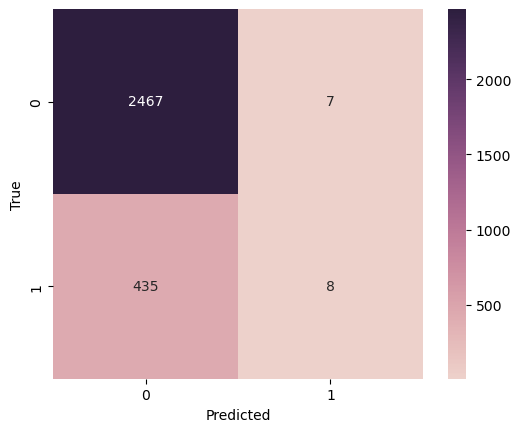

In [158]:
y_pred_test = cat_model.predict(pool_test)
y_pred_proba_test = cat_model.predict_proba(pool_test)[:, 1]

acc_test = accuracy_score(y_test, y_pred_test)
prec_test = precision_score(y_test, y_pred_test)
rec_test = recall_score(y_test, y_pred_test)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test)
gini_test = 2*roc_auc_test-1
print(f'''Accuracy (test): {acc_test:.3f}
Precision (test): {prec_test:.3f}
Recall (test): {rec_test:.3f}
RocAuc (test): {roc_auc_test:.3f}
GINI (test): {gini_test:.3f}
''')

cm = confusion_matrix(y_test, y_pred_test)
ax = sns.heatmap(cm, cmap=sns.cubehelix_palette(as_cmap=True), annot=True, fmt='d', square=True)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

Text(0.5, 1.0, 'Feature Importance')

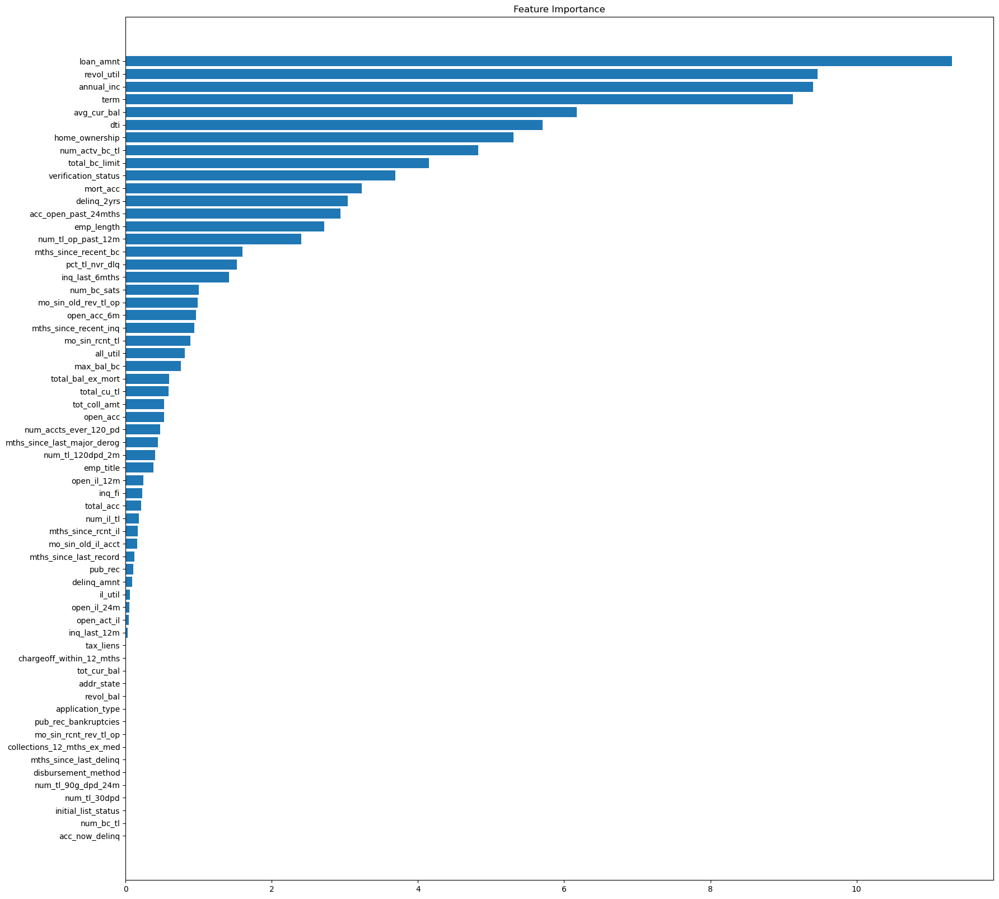

In [159]:
feature_importance = cat_model.feature_importances_
sorted_idx = np.argsort(feature_importance)
fig = plt.figure(figsize=(20, 20))
plt.barh(range(len(sorted_idx)), feature_importance[sorted_idx], align='center')
plt.yticks(range(len(sorted_idx)), np.array(X_test.columns)[sorted_idx])
plt.title('Feature Importance')

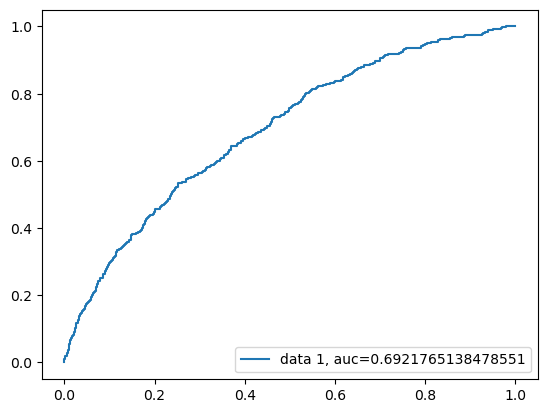

In [160]:
y_pred_proba = cat_model.predict_proba(pool_test)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

#### Random Forest

In [161]:
#random forest
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

In [162]:
list(X_test.select_dtypes(include=['datetime64']).columns)

[]

In [163]:
cat_cols

['addr_state',
 'application_type',
 'disbursement_method',
 'emp_title',
 'home_ownership',
 'initial_list_status',
 'verification_status']

In [164]:
X_train_rfc = X_train.copy()
X_test_rfc = X_test.copy()

# One-hot encoding for training set and drop the original columns
sub_grade_home_ownership_dummies = pd.get_dummies(X_train_rfc[[
'addr_state',
 'application_type',
 'disbursement_method',
 'emp_title',
 'home_ownership',
 'initial_list_status',
 'verification_status']])
X_train_rfc = pd.concat([X_train_rfc, sub_grade_home_ownership_dummies], axis=1)
X_train_rfc = X_train_rfc.drop([
'addr_state',
 'application_type',
 'disbursement_method',
 'emp_title',
 'home_ownership',
 'initial_list_status',
 'verification_status'], axis=1)

# One-hot encoding for test set and drop the original columns
sub_grade_home_ownership_dummies_test = pd.get_dummies(X_test_rfc[[
'addr_state',
 'application_type',
 'disbursement_method',
 'emp_title',
 'home_ownership',
 'initial_list_status',
 'verification_status']])
X_test_rfc = pd.concat([X_test_rfc, sub_grade_home_ownership_dummies_test], axis=1)
X_test_rfc = X_test_rfc.drop([
'addr_state',
 'application_type',
 'disbursement_method',
 'emp_title',
 'home_ownership',
 'initial_list_status',
 'verification_status'], axis=1)

# To ensure the test dataset has the same columns as the training dataset
X_test_rfc = X_test_rfc.reindex(columns = X_train_rfc.columns, fill_value=0)

In [165]:
# Create a Random Forest Classifier
clf = RandomForestClassifier(n_estimators=2000, max_depth=3, n_jobs=-1, criterion='entropy')

# Train the model using the training sets
clf.fit(X_train_rfc, y_train)

RandomForestClassifier(criterion='entropy', max_depth=3, n_estimators=2000,
                       n_jobs=-1)

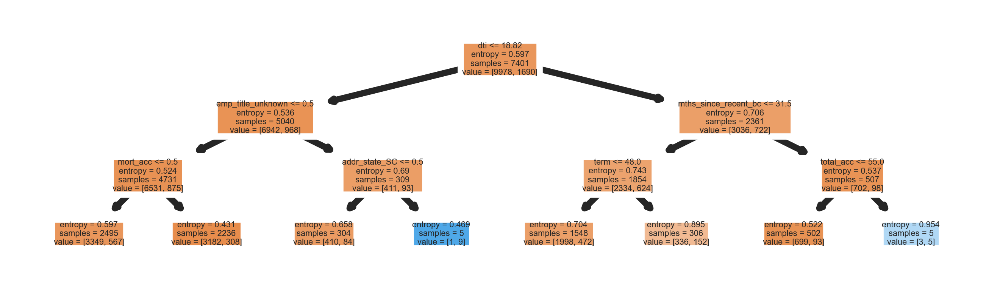

In [213]:
from sklearn.tree import export_graphviz, plot_tree

export_graphviz(
    rfc.estimators_[0],
    feature_names=X_train_rfc.columns,
    filled=True,
    rounded=False
)

fig, axes = plt.subplots(nrows = 1,ncols = 1,figsize = (4,1), dpi=800)
plot_tree(
    rfc.estimators_[0],
    feature_names = X_train_rfc.columns,
    filled = True
)

fig.savefig('rf_individualtree.png')

Accuracy (train): 0.854
Precision (train): 0.000
Recall (train): 0.000
RocAuc (train): 0.722
GINI (train): 0.384



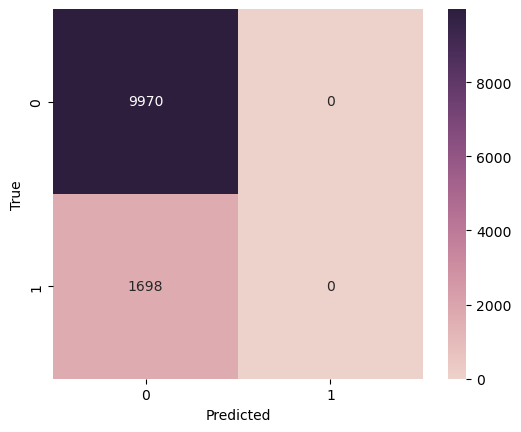

In [166]:
y_pred_train_clf = clf.predict(X_train_rfc)
y_pred_proba_train_clf = clf.predict_proba(X_train_rfc)[:, 1]

acc_train = accuracy_score(y_train, y_pred_train_clf)
prec_train = precision_score(y_train, y_pred_train_clf)
rec_train = recall_score(y_train, y_pred_train_clf)
roc_auc_train = roc_auc_score(y_train, y_pred_proba_train_clf)
gini_train = 2*roc_auc_test-1
print(f'''Accuracy (train): {acc_train:.3f}
Precision (train): {prec_train:.3f}
Recall (train): {rec_train:.3f}
RocAuc (train): {roc_auc_train:.3f}
GINI (train): {gini_train:.3f}
''')

cm = confusion_matrix(y_train, y_pred_train_clf)
ax = sns.heatmap(cm, cmap=sns.cubehelix_palette(as_cmap=True), annot=True, fmt='d', square=True)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

Accuracy (test): 0.848
Precision (test): 0.000
Recall (test): 0.000
RocAuc (test): 0.677
GINI (test): 0.354



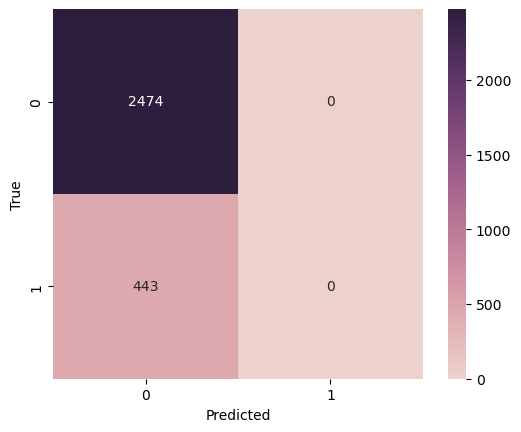

In [167]:
y_pred_test_clf = clf.predict(X_test_rfc)
y_pred_proba_test_clf = clf.predict_proba(X_test_rfc)[:, 1]

acc_test = accuracy_score(y_test, y_pred_test_clf)
prec_test = precision_score(y_test, y_pred_test_clf)
rec_test = recall_score(y_test, y_pred_test_clf)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test_clf)
gini_test = 2*roc_auc_test-1
print(f'''Accuracy (test): {acc_test:.3f}
Precision (test): {prec_test:.3f}
Recall (test): {rec_test:.3f}
RocAuc (test): {roc_auc_test:.3f}
GINI (test): {gini_test:.3f}
''')

cm = confusion_matrix(y_test, y_pred_test_clf)
ax = sns.heatmap(cm, cmap=sns.cubehelix_palette(as_cmap=True), annot=True, fmt='d', square=True)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

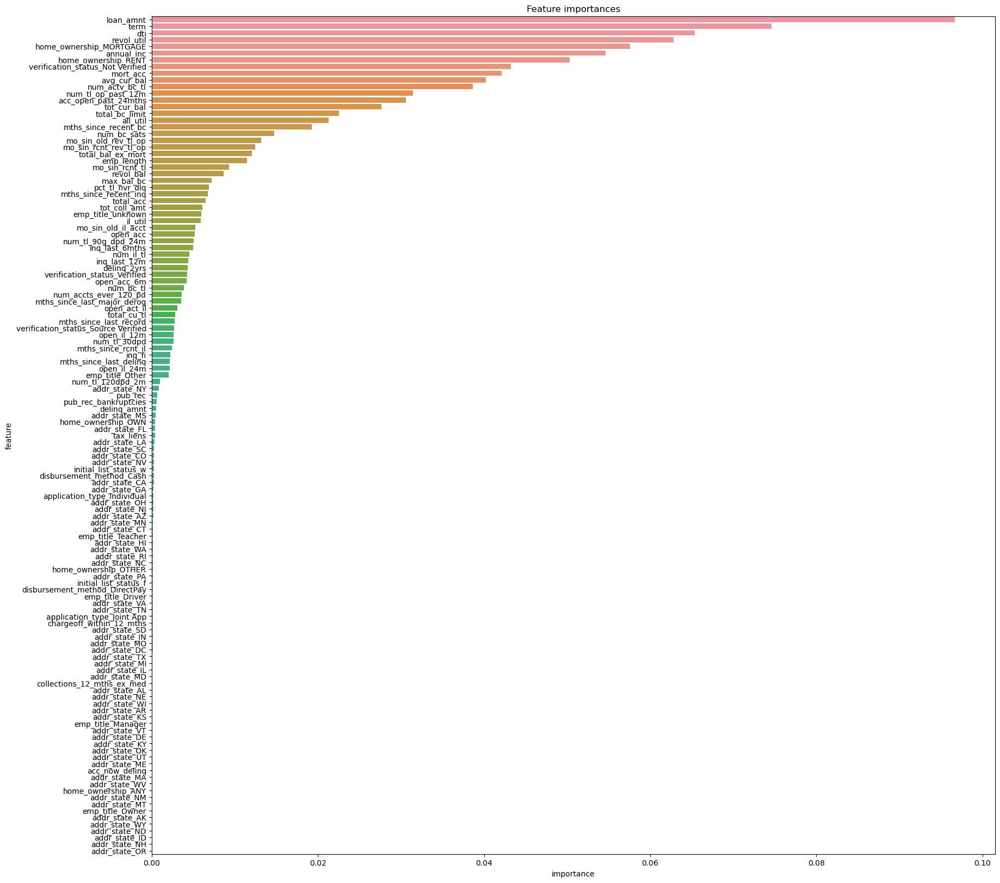

In [168]:
# Get feature importances
importances = clf.feature_importances_

# Create a data frame for visualization
feature_importances = pd.DataFrame({"feature": X_train_rfc.columns, "importance": importances})

# Sort the data frame by importance in descending order
feature_importances = feature_importances.sort_values("importance", ascending=False)

plt.figure(figsize=(20,20))
plt.title("Feature importances")
sns.barplot(x=feature_importances.importance, y=feature_importances.feature)
plt.show()

In [169]:
feature_importances.head(10)

,feature,importance
15,loan_amnt,0.096675
48,term,0.074611
9,dti,0.065366
46,revol_util,0.062826
116,home_ownership_MORTGAGE,0.057589
3,annual_inc,0.054654
119,home_ownership_RENT,0.050331
122,verification_status_Not Verified,0.043216
21,mort_acc,0.042104
4,avg_cur_bal,0.040253


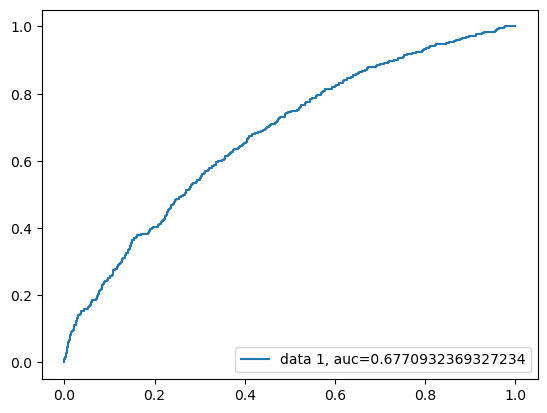

In [170]:
y_pred_proba = clf.predict_proba(X_test_rfc)[::,1]
fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)
plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.legend(loc=4)
plt.show()

#### LogReg

In [171]:
# Create a Logistic Regression Classifier
lr = LogisticRegression(solver='liblinear', max_iter=1000)

lr.fit(X_train_rfc, y_train)

LogisticRegression(max_iter=1000, solver='liblinear')

Model params: {'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, 'l1_ratio': None, 'max_iter': 1000, 'multi_class': 'auto', 'n_jobs': None, 'penalty': 'l2', 'random_state': None, 'solver': 'liblinear', 'tol': 0.0001, 'verbose': 0, 'warm_start': False}
Train Result:
Accuracy (train): 0.854
Precision (train): 0.462
Recall (train): 0.011
RocAuc (train): 0.698
GINI (train): 0.354



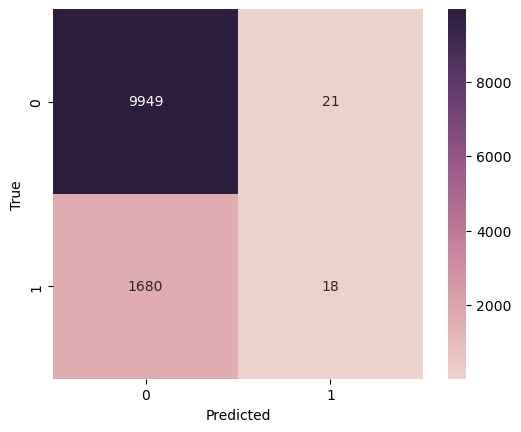

In [172]:
#print_score(model, X_train, y_train, X_test, y_test, train=True)
print("Model params:", lr.get_params())

y_pred_lr = lr.predict(X_train_rfc)
y_pred_proba_train_lr = lr.predict_proba(X_train_rfc)[:, 1]

accuracy = accuracy_score(y_train, y_pred_lr)
precision = precision_score(y_train, y_pred_lr)
recall = recall_score(y_train, y_pred_lr)
roc_auc_train = roc_auc_score(y_train, y_pred_proba_train_lr)
gini_train = 2*roc_auc_test-1
print("Train Result:")
print(f'''Accuracy (train): {accuracy:.3f}
Precision (train): {precision:.3f}
Recall (train): {recall:.3f}
RocAuc (train): {roc_auc_train:.3f}
GINI (train): {gini_train:.3f}
''')

cm = confusion_matrix(y_train, y_pred_lr)
ax = sns.heatmap(cm, cmap=sns.cubehelix_palette(as_cmap=True), annot=True, fmt='d', square=True)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

Model params: {'C': 1.0, 'class_weight': None, 'dual': False, 'fit_intercept': True, 'intercept_scaling': 1, 'l1_ratio': None, 'max_iter': 1000, 'multi_class': 'auto', 'n_jobs': None, 'penalty': 'l2', 'random_state': None, 'solver': 'liblinear', 'tol': 0.0001, 'verbose': 0, 'warm_start': False}
Train Result:
Accuracy (test): 0.848
Precision (test): 0.519
Recall (test): 0.032
RocAuc (test): 0.681
GINI (test): 0.361



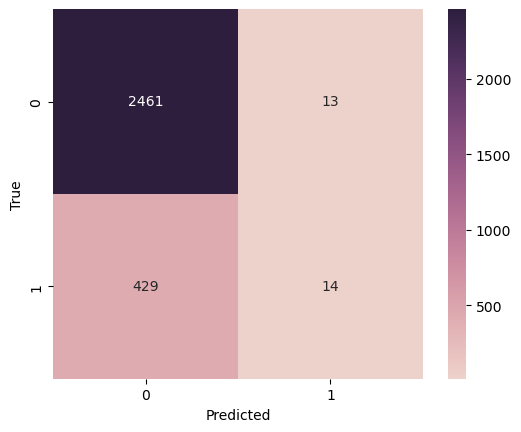

In [173]:
#print_score(model, X_train, y_train, X_test, y_test, train=True)
print("Model params:", lr.get_params())

y_pred_lr = lr.predict(X_test_rfc)
y_pred_proba_test_lr = lr.predict_proba(X_test_rfc)[:, 1]

accuracy = accuracy_score(y_test, y_pred_lr)
precision = precision_score(y_test, y_pred_lr)
recall = recall_score(y_test, y_pred_lr)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test_lr)
gini_test = 2*roc_auc_test-1
print("Train Result:")
print(f'''Accuracy (test): {accuracy:.3f}
Precision (test): {precision:.3f}
Recall (test): {recall:.3f}
RocAuc (test): {roc_auc_test:.3f}
GINI (test): {gini_test:.3f}
''')

cm = confusion_matrix(y_test, y_pred_lr)
ax = sns.heatmap(cm, cmap=sns.cubehelix_palette(as_cmap=True), annot=True, fmt='d', square=True)
ax.set_xlabel('Predicted')
ax.set_ylabel('True');

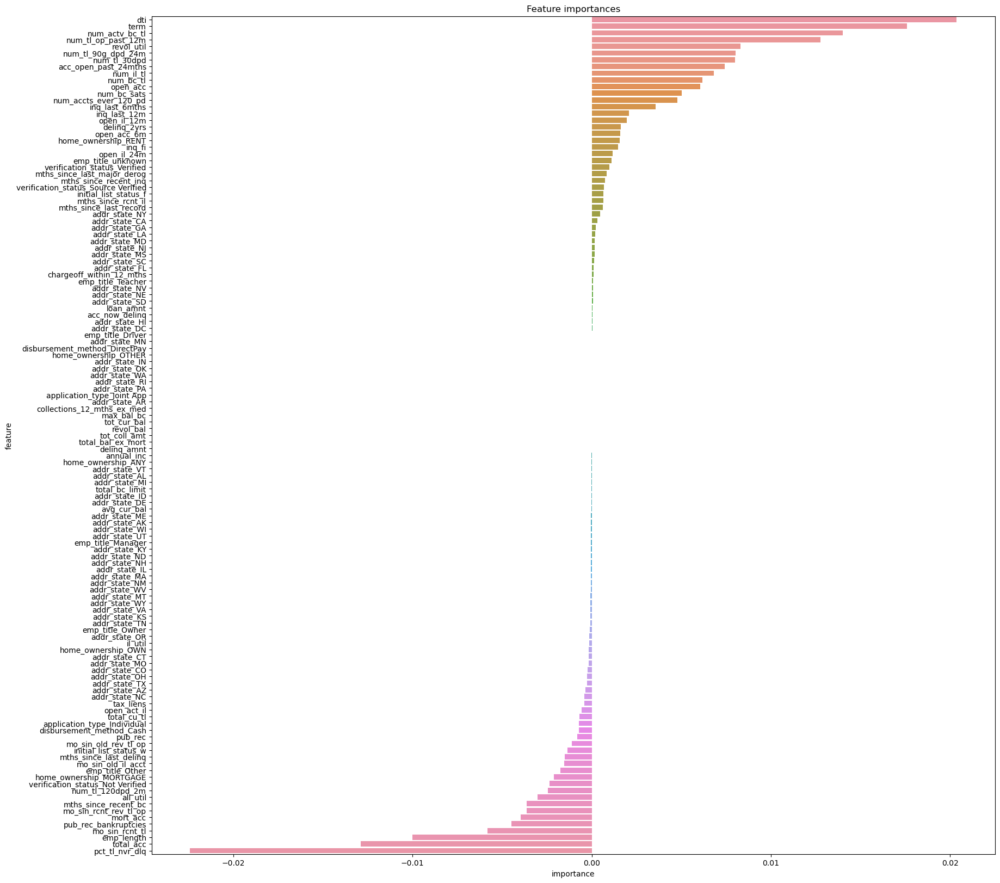

In [174]:
# Get coefficients
coefficients = lr.coef_[0]

# Create a data frame for visualization
feature_importances = pd.DataFrame({"feature": X_train_rfc.columns, "importance": coefficients})

# Sort the data frame by importance in descending order
feature_importances = feature_importances.sort_values("importance", ascending=False)

plt.figure(figsize=(20,20))
plt.title("Feature importances")
sns.barplot(x=feature_importances.importance, y=feature_importances.feature)
plt.show()

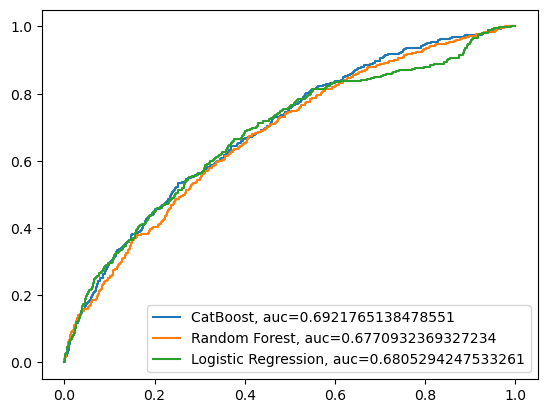

In [175]:
# Predicted probabilities for CatBoost model
y_pred_proba_cat = cat_model.predict_proba(pool_test)[::,1]
fpr_cat, tpr_cat, _ = metrics.roc_curve(y_test,  y_pred_proba_cat)
auc_cat = metrics.roc_auc_score(y_test, y_pred_proba_cat)

# Predicted probabilities for Random Forest model
y_pred_proba_clf = clf.predict_proba(X_test_rfc)[::,1]
fpr_clf, tpr_clf, _ = metrics.roc_curve(y_test,  y_pred_proba_clf)
auc_clf = metrics.roc_auc_score(y_test, y_pred_proba_clf)

# Predicted probabilities for Logistic Regression model
y_pred_proba_lr = lr.predict_proba(X_test_rfc)[::,1]
fpr_lr, tpr_lr, _ = metrics.roc_curve(y_test,  y_pred_proba_lr)
auc_lr = metrics.roc_auc_score(y_test, y_pred_proba_lr)

# Plot the ROC curves
plt.plot(fpr_cat, tpr_cat, label=f"CatBoost, auc={auc_cat}")
plt.plot(fpr_clf, tpr_clf, label=f"Random Forest, auc={auc_clf}")
plt.plot(fpr_lr, tpr_lr, label=f"Logistic Regression, auc={auc_lr}")
plt.legend(loc=0)
plt.show()

In [176]:
# Create a DataFrame to hold results
results_df = pd.DataFrame(columns=['Model', 'Accuracy', 'Precision', 'Recall', 'RocAuc', 'GINI'])

# Logistic Regression
y_pred_lr = lr.predict(X_test_rfc)
y_pred_proba_train_lr = lr.predict_proba(X_test_rfc)[:, 1]

accuracy = accuracy_score(y_test, y_pred_lr)
precision = precision_score(y_test, y_pred_lr)
recall = recall_score(y_test, y_pred_lr)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test_lr)
gini_test = 2*roc_auc_test-1
results_df.loc[len(results_df)] = ['Logistic Regression', accuracy, precision, recall, roc_auc_test, gini_test]

# Random Forest Classifier
y_pred_test_clf = clf.predict(X_test_rfc)
y_pred_proba_test_clf = clf.predict_proba(X_test_rfc)[:, 1]

accuracy = accuracy_score(y_test, y_pred_test_clf)
precision = precision_score(y_test, y_pred_test_clf)
recall = recall_score(y_test, y_pred_test_clf)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test_clf)
gini_test = 2*roc_auc_test-1
results_df.loc[len(results_df)] = ['Random Forest', accuracy, precision, recall, roc_auc_test, gini_test]

# CatBoost
y_pred_test_cat = cat_model.predict(pool_test)
y_pred_proba_test_cat = cat_model.predict_proba(pool_test)[:, 1]

accuracy = accuracy_score(y_test, y_pred_test_cat)
precision = precision_score(y_test, y_pred_test_cat)
recall = recall_score(y_test, y_pred_test_cat)
roc_auc_test = roc_auc_score(y_test, y_pred_proba_test_cat)
gini_test = 2*roc_auc_test-1
results_df.loc[len(results_df)] = ['CatBoost', accuracy, precision, recall, roc_auc_test, gini_test]

# Define a function to highlight the maximum in a Series yellow.
def highlight_max(s):
    '''
    highlight the maximum in a series.
    '''
    is_max = s == s.max()
    return ['background-color: green' if v else '' for v in is_max]

# Apply the function to the results DataFrame
results_df.style.apply(highlight_max, subset=['Accuracy', 'Precision', 'Recall', 'RocAuc', 'GINI'])


,Model,Accuracy,Precision,Recall,RocAuc,GINI
0,Logistic Regression,0.848474,0.518519,0.031603,0.680529,0.361059
1,Random Forest,0.848132,0.000000,0.000000,0.677093,0.354186
2,CatBoost,0.848474,0.533333,0.018059,0.692177,0.384353


#### LGD Model

#### Benefit curve

In [177]:
df_b = X_test_lgd.copy(deep=False)

In [178]:
df_b['proba'] = y_pred_proba_test_clf
df_b['def'] = y_test

In [179]:
df_b

,acc_now_delinq,acc_open_past_24mths,addr_state,all_util,annual_inc,application_type,avg_cur_bal,chargeoff_within_12_mths,collections_12_mths_ex_med,delinq_2yrs,delinq_amnt,disbursement_method,dti,emp_length,emp_title,fico_range_low,home_ownership,il_util,initial_list_status,inq_fi,inq_last_12m,inq_last_6mths,loan_amnt,max_bal_bc,mo_sin_old_il_acct,mo_sin_old_rev_tl_op,mo_sin_rcnt_rev_tl_op,mo_sin_rcnt_tl,mort_acc,mths_since_last_delinq,mths_since_last_major_derog,mths_since_last_record,mths_since_rcnt_il,mths_since_recent_bc,mths_since_recent_inq,num_accts_ever_120_pd,num_actv_bc_tl,num_bc_sats,num_bc_tl,num_il_tl,num_tl_120dpd_2m,num_tl_30dpd,num_tl_90g_dpd_24m,num_tl_op_past_12m,open_acc,open_acc_6m,open_act_il,open_il_12m,open_il_24m,pct_tl_nvr_dlq,pub_rec,pub_rec_bankruptcies,revol_bal,revol_util,tax_liens,term,tot_coll_amt,tot_cur_bal,total_acc,total_bal_ex_mort,total_bc_limit,total_cu_tl,verification_status,lgd,proba,def
7073,0.0,6.0,CA,44.0,120000.0,Individual,26591.0,0.0,0.0,0.0,0.0,Cash,39.33,10,Other,780.0,MORTGAGE,83.0,w,2.0,4.0,0.0,25000.0,16340.0,121.0,200.0,12.0,2.0,1.0,NaN,NaN,NaN,2.0,39.0,1.0,0.0,3.0,8.0,10.0,10.0,0.0,0.0,0.0,5.0,15.0,2.0,5.0,4.0,5.0,100.0,0.0,0.0,20099.0,20.5,0.0,36,0.0,345688.0,25.0,197977.0,92000.0,0.0,Verified,0.700000,0.152557,0
11168,0.0,5.0,MO,NaN,114000.0,Individual,3385.0,0.0,0.0,0.0,0.0,Cash,18.03,7,Other,700.0,OWN,NaN,f,NaN,NaN,0.0,3000.0,NaN,122.0,231.0,1.0,1.0,2.0,61.0,61.0,NaN,NaN,24.0,5.0,1.0,3.0,4.0,5.0,8.0,0.0,0.0,0.0,2.0,10.0,NaN,NaN,NaN,NaN,95.0,0.0,0.0,8416.0,40.7,0.0,36,0.0,30469.0,20.0,30469.0,16700.0,NaN,Not Verified,0.700000,0.158081,0
19439,0.0,3.0,PA,NaN,100000.0,Individual,11503.0,0.0,0.0,0.0,0.0,Cash,16.02,3,Other,770.0,MORTGAGE,NaN,f,NaN,NaN,0.0,6000.0,NaN,153.0,301.0,7.0,7.0,1.0,NaN,NaN,NaN,NaN,163.0,17.0,0.0,1.0,2.0,5.0,8.0,0.0,0.0,0.0,1.0,6.0,NaN,NaN,NaN,NaN,100.0,0.0,0.0,10788.0,40.0,0.0,36,0.0,69015.0,20.0,69015.0,17700.0,NaN,Not Verified,0.700000,0.133749,0
11801,0.0,6.0,WY,NaN,115200.0,Individual,30664.0,0.0,0.0,0.0,0.0,Cash,12.58,3,Other,745.0,OWN,NaN,f,NaN,NaN,0.0,7500.0,NaN,165.0,121.0,20.0,6.0,8.0,NaN,NaN,NaN,NaN,20.0,4.0,0.0,4.0,7.0,13.0,14.0,0.0,0.0,0.0,2.0,12.0,NaN,NaN,NaN,NaN,100.0,0.0,0.0,19857.0,37.1,0.0,36,0.0,367963.0,38.0,57785.0,53500.0,NaN,Not Verified,0.700000,0.142469,0
167,0.0,4.0,PA,66.0,73000.0,Individual,13493.0,0.0,0.0,0.0,0.0,Cash,32.50,1,Other,710.0,OWN,80.0,w,1.0,1.0,0.0,3500.0,13598.0,154.0,194.0,29.0,4.0,3.0,NaN,NaN,NaN,17.0,29.0,6.0,0.0,3.0,6.0,8.0,21.0,0.0,0.0,0.0,1.0,20.0,1.0,12.0,0.0,3.0,100.0,0.0,0.0,19664.0,38.9,0.0,36,1272.0,269852.0,37.0,97064.0,49000.0,7.0,Not Verified,0.700000,0.137076,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
18365,0.0,5.0,NC,NaN,79000.0,Individual,11782.0,0.0,0.0,0.0,0.0,Cash,21.89,7,Other,695.0,MORTGAGE,NaN,w,NaN,NaN,1.0,5000.0,NaN,131.0,161.0,4.0,4.0,1.0,NaN,NaN,NaN,NaN,26.0,4.0,0.0,3.0,3.0,7.0,6.0,0.0,0.0,0.0,3.0,13.0,NaN,NaN,NaN,NaN,100.0,0.0,0.0,8359.0,47.5,0.0,36,0.0,153161.0,20.0,40101.0,3200.0,NaN,Not Verified,0.700000,0.147252,0
18088,0.0,4.0,OH,39.0,60000.0,Individual,3081.0,0.0,0.0,0.0,0.0,Cash,16.36,5,Other,725.0,RENT,63.0,f,0.0,1.0,0.0,6000.0,5108.0,123.0,120.0,11.0,11.0,0.0,NaN,NaN,NaN,31.0,11.0,11.0,0.0,4.0,8.0,15.0,10.0,0.0,0.0,0.0,1.0,17.0,0.0,3.0,0.0,0.0,100.0,0.0,0.0,15958.0,23.0,0.0,36,0.0,46218.0,34.0,46218.0,50300.0,1.0,Not Verified,0.700000,0.150503,0
4331,0.0,0.0,FL,90.0,16000.0,Individual,2523.0,0.0,0.0,0.0,0.0,Cash,15.08,1,Other,675.0,RENT,NaN,f,0.0,1.0,0.0,11600.0,3021.0,57.0,64.0,31.0,31.0,0.0,NaN,NaN,NaN,57.0,31.0,6.0,0.0,3.0,3.0,3.0,1.0,0.0,0.0,0.0,0.0,3.0,0.0,0.0,0.0,0.0,100.0,0.0,0.0,7568.0,90.1,0.0,36,0.0,7568.0,4.0,7568.0,8400.0,0.0,Verified,0.845222,0.199016,1
19139,0.0,5.0,OR,NaN,76000.0,Individual,5904.0,0.0,0.0,1.0,0.0,Cash,13.07,1,Other,710.

In [180]:
df_b.dtypes

acc_now_delinq          float64
acc_open_past_24mths    float64
addr_state               object
all_util                float64
annual_inc              float64
                         ...   
total_cu_tl             float64
verification_status      object
lgd                     float64
proba                   float64
def                       int64
Length: 66, dtype: object

In [181]:
df_b['proba'].sort_values()

7473     0.090654
6965     0.092702
5858     0.094751
15370    0.094928
14988    0.096101
           ...   
2561     0.242626
18831    0.244783
11517    0.252185
2296     0.255745
3368     0.262871
Name: proba, Length: 2917, dtype: float64

In [182]:
df_b['proba'].mean()

0.16524166804488596

<Axes: xlabel='proba', ylabel='Density'>

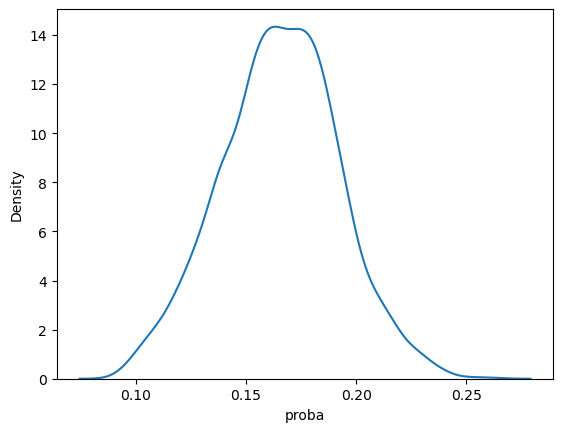

In [183]:
sns.kdeplot(df_b['proba'])

In [184]:
df_lgd = pd.read_csv('car_loan.csv', decimal=".")

In [185]:
def construct_lgd_model(X, y, lgd, num_columns):

    y_lgd = lgd    
    
    model_lgd = RandomForestRegressor(max_depth=3, n_estimators=2000, n_jobs=-1, criterion='squared_error')

    model_lgd.fit(X, y)
    
    return model_lgd

model_lgd = construct_lgd_model(X_train_rfc, y_train, lgd_train, num_columns)

y_pred_lgd = model_lgd.predict(X_test_rfc)

In [186]:
print('RMSE: {}'.format(mean_squared_error(lgd_test, y_pred_lgd)))
print('RMSE on Charged Off: {}'.format(mean_squared_error(lgd_test[y_test > 0], model_lgd.predict(X_test_rfc[y_test > 0]))))

print('lgd predictions stats: min->{:.4f}, max->{:.4f}, mean->{:.4f}'.format(y_pred_lgd.min(), y_pred_lgd.max(), y_pred_lgd.mean()))

RMSE: 0.2926895497650329
RMSE on Charged Off: 0.29036840134267355
lgd predictions stats: min->0.0722, max->0.3973, mean->0.1646


In [187]:
X_train_rfc.shape

(11668, 125)

In [188]:
X_test_rfc.shape

(2917, 125)

In [189]:
class NPV_estimator():
    def __init__(self, X, y, model, df=df_lgd, model_lgd=None):
        self.NPV = X.copy()
        self.X = X.copy()
        self.y = y.copy()
        self.DF = df[df.index.isin(self.y.index)]
        
        self.model = model
        
        predicted_class = self.model.predict(self.NPV)
        default_proba = self.model.predict_proba(self.NPV)[:, 1]
        
        
        if model_lgd is None:
            print('Default lgd values')
            self.model_lgd = None
            self.NPV['lgd'] = 0.6732984687106469
        else:
            print('Model lgd predicts')
            self.model_lgd = model_lgd
            self.NPV['lgd'] = self.model_lgd.predict(self.NPV)
        self.NPV['default'] = y
        self.NPV['predicted_class'] = predicted_class
        self.NPV['default_proba'] = default_proba
        self.NPV = self.NPV.sort_values(by=['default_proba'], ascending=True)
        
        self.NPV['gain'] = self.NPV['loan_amnt'] * self.DF['int_rate'] / 100
        self.NPV['loss'] = self.NPV['loan_amnt'] * self.NPV['lgd']
        
        
        self.benefit = []
        self.acc_rates = []
        self.tpr = []
        self.fpr = []
        self.cutoff = []
        self.mapper = {}
        self.precision = []
        self.recall = []
    
    def plot(self, draw='benefit', show=True, score_type='youden', savgol=False, window_size=100, dim=3, label=None):
        
        cut_off = self.roc_optimal_threshold(score_type)
        
        if show:
            plt.figure(figsize=(15, 15))
            
        if draw == 'benefit':
            plt.title('Benefit with regards to acceptance rate ({})'.format(score_type))
            plt.xlabel('Acceptance Rate')
            plt.ylabel('Benefit')
            benefit_y = self.benefit
            
            if savgol:
                benefit_y = savgol_filter(self.benefit, window_size, dim)

            
            plt.plot(self.acc_rates, benefit_y, '-o', markersize=1)
            
            loc = self.mapper[cut_off['cutoff']]
            point=(self.acc_rates[loc], benefit_y[loc])
            point_2 = self.max_benefit_point(self.acc_rates, benefit_y)
            
            plt.scatter(point[0], point[1], c='red')
            plt.scatter(point_2[0], point_2[1], c='green')
            if show:
                y_low = min(benefit_y) - 0.01 * abs(min(benefit_y))
                y_high = 1.01 * max(benefit_y)
                plt.xlim(0, 1.0)
                plt.ylim(y_low, y_high)
                plt.plot((point[0], point[0]), (y_low, point[1]), linestyle='dashed', c='red')
                plt.plot((0, point[0]), (point[1], point[1]), linestyle='dashed', c='red')
                plt.plot((point_2[0], point_2[0]), (y_low, point_2[1]), linestyle='dashed', c='green')
                plt.plot((0, point_2[0]), (point_2[1], point_2[1]), linestyle='dashed', c='green')
                plt.show()
                
        elif draw == 'auc':
            plt.title('ROC-AUC Curve ({})'.format(score_type))
            if label is None:
                plt.plot(self.fpr, self.tpr)
            else:
                plt.plot(self.fpr, self.tpr, label=label)
            plt.scatter(cut_off['fpr'], cut_off['tpr'], c='red')
            if show:
                plt.plot((0, cut_off['fpr']), (cut_off['tpr'], cut_off['tpr']), linestyle='dashed', c='red')
                plt.plot((cut_off['fpr'], cut_off['fpr']), (0, cut_off['tpr']), linestyle='dashed', c='red')
                plt.xlim(0, 1.0)
                plt.ylim(0, 1.0)
                plt.show()

    def roc_optimal_threshold(self, score_type = 'youden'):
        
        cut = pd.DataFrame(np.array([self.precision, self.recall, self.cutoff, self.fpr, self.tpr]).T, columns = [
            'precision',
            'recall',
            'cutoff',
            'fpr',
            'tpr'
        ])
        cut["youden"] = cut['tpr'] - cut['fpr']

        cut['f1score'] = 0
        cond = cut['precision'] + cut['recall'] > 0
        cut.loc[cond, 'f1score'] = 2 * cut['precision'] * cut['recall'] / (cut['recall'] + cut['precision'])
        
        if score_type == 'youden':
            cut_off = cut.sort_values(by="youden", ascending=False, ignore_index=True).iloc[0]
        else:
            cut_off = cut.sort_values(by="f1score", ascending=False, ignore_index=True).iloc[0]

        return cut_off.to_dict()
    
    def max_benefit_point(self, acc_rates, benefit):
        max_benefit_idx = np.argmax(np.array(benefit))
        point = (acc_rates[max_benefit_idx], benefit[max_benefit_idx])
        return point
            
    def calc_benefit_and_tpr(self, max_a=100):        
        for a in range(0, max_a + 1):
            #positive class is a default
            cut_off = a / 100
            positive = self.NPV[self.NPV['default_proba'] >= cut_off]
            negative = self.NPV[self.NPV['default_proba'] < cut_off]
            true_positive = positive[positive['default'] == 1]
            true_negative = negative[negative['default'] == 0]
            TN, TP = len(true_negative), len(true_positive)
            FP, FN = len(positive) - TP, len(negative) - TN

            tpr = 0
            if TP + FN > 0:
                tpr = TP / (TP + FN)
            self.tpr.append(tpr)

            fpr = 0
            if FP + TN > 0:
                fpr = FP / (FP + TN)
            self.fpr.append(fpr)
            
            precision = 0
            if TP + FP > 0:
                precision = TP / (TP + FP)
            self.precision.append(precision)
            
            recall = 0
            if TP + FN > 0:
                recall = TP / (TP + FN)
            self.recall.append(recall)
            
            self.cutoff.append(cut_off)
            
            #true negative class
            total_gain = true_negative['gain'].sum()
            #false negative class
            total_loss = negative[negative['default']==1]['loss'].sum()

            benefit_iter = total_gain - total_loss  
            self.benefit.append(benefit_iter)
            acc_rate = len(negative) / len(self.NPV)
            self.mapper[cut_off] = a
            self.acc_rates.append(acc_rate)
            
    def get_scores(self):
        return roc_auc_score(self.NPV['default'], self.NPV['default_proba'])
    
    def get_total_diff(self):
        return self.NPV['gain'] * (1 - self.NPV['default_proba']) - self.NPV['loss'] * self.NPV['default_proba']
    
    def get_npv(self):
        return self.NPV
    
    def get_tpr(self):
        return self.tpr
    
    def get_fpr(self):
        return self.fpr
                                                
    def get_recall(self):
        return self.recall
                                
    def get_precision(self):
        return self.precision

In [190]:
score_type = 'f1score'

Default lgd values


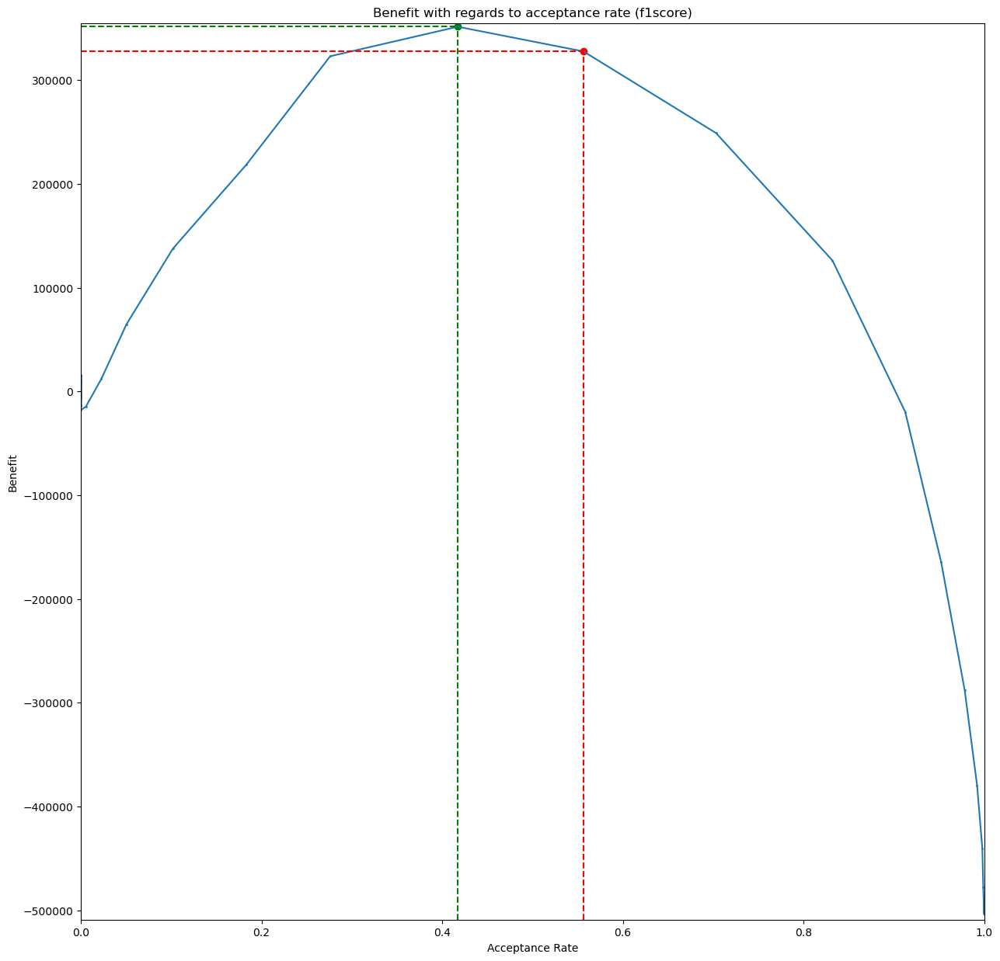

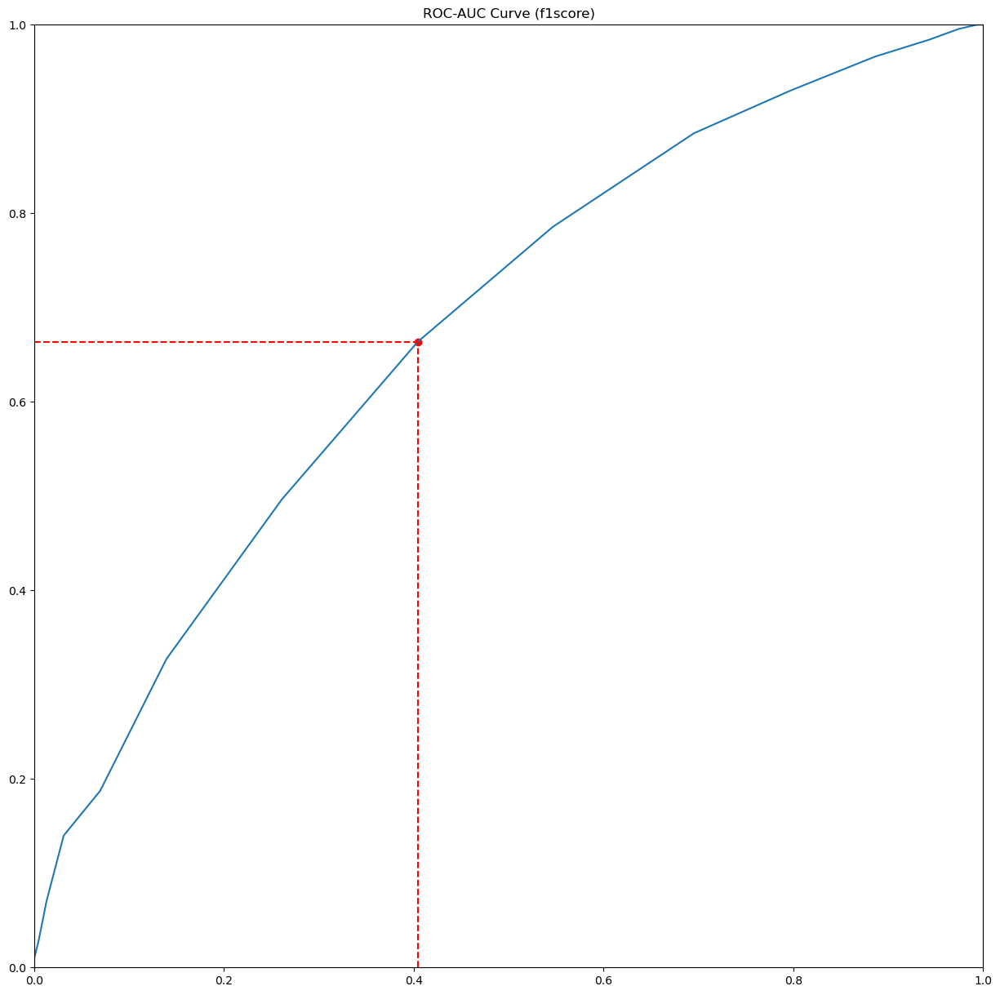

In [191]:
from scipy.signal import savgol_filter

NPV_estimator_lgbm = NPV_estimator(X_test_rfc, y_test, clf, model_lgd=None)
NPV_estimator_lgbm.calc_benefit_and_tpr(max_a=100)
NPV_estimator_lgbm.plot('benefit', score_type=score_type, savgol=True, window_size=30, dim=10)
NPV_estimator_lgbm.plot('auc', score_type=score_type)

#### Validation test

In [192]:
def gini_curve(model, X_test, y_test):
    '''
        Рисуем кривую Gini
        input:
            - model - ваша модель
            - X_test - набор данных
            - y_test - разметка данных
        
        output:
            Ничего. Рисует график.
    '''
    # Получаем прогнозы модели на тестовом наборе данных
    y_pred = model.predict_proba(X_test)[:, 1]
    
    data = zip(y_test, y_pred)
    sorted_data = sorted(data, key=lambda d: d[1], reverse=True)
    sorted_actual = [d[0] for d in sorted_data]
    cumulative_actual = np.cumsum(sorted_actual) / sum(y_test)
    cumulative_index = np.arange(1, len(cumulative_actual)+1) / len(y_pred)
    
    gini = 2*roc_auc_score(y_test, y_pred)-1
    
    x_values = [0] + list(cumulative_index)
    y_values = [0] + list(cumulative_actual)

    plt.plot(x_values, y_values, color='green')
    plt.plot([0,1], [0,1], '--', color='green') # линия равенства
    plt.fill_between(x_values, x_values, y_values, color = 'green', alpha=0.5)
    plt.title(f'GINI: {round(gini, 3)}')
    plt.show()
    
    
def plot_prob_distr(y, y_pred_proba):
    '''
        Отобразим распределение вероятностей для положительных и отрицательных классов 
        input:
            - y - разметка
            - y_pred_proba - вероятность по модели
        
        output:
            Ничего. Рисует график.
    '''
    y_together = pd.DataFrame(zip(y, y_pred_proba), columns = ['y', 'y_pred_proba'])
    fig = go.Figure(
        data=[
            go.Histogram(
                x = y_together[y_together['y'] == 1].y_pred_proba,
                name = 'Дефолт'
            ),
            go.Histogram(
                x = y_together[y_together['y'] == 0].y_pred_proba,
                name = 'Отсутвие дефолта'
            )
        ]
    )
    fig.show()
    

def calculate_feature_importants_4_each_feature(sorted_data, X_train, X_test, y_train, y_test, X_valid=None, y_val=None):
    """
        Возвращает feature importance для каждого признака.
        input:
            sorted_data - список кортежей [('Наименование признака', NUM),] где NUM - feature importance. Список отсортирован.
            X_train, X_test, y_train, y_test - наборы данных с разметкой
            X_valid, y_valid - набор на валидацию. Необязательный параметр
        
        output:
            3 списка, если передавался X_valid.
            2 списка, если без X_valid.
            Возвращает списки значений для каждого набора данных, а именно
                0. Признак
                1. Джини
                2. Джини Up
                3. feature importants
    """
    result_list_train = []
    result_list_test = []
    if X_valid is not None:
        result_list_val = []
    # Структура: Добавили признак - получили джини - разнгица с последним джини - feature_importants
    previous_feature_name = list()
    
    for feat_name, feat_important in tqdm.tqdm(sorted_data):
        rfc = RandomForestClassifier(n_estimators=300, criterion='gini', max_depth=3, n_jobs=-1)
        rfc.fit(X_train[previous_feature_name + [feat_name]], y_train.values)

        roc_auc_train = np.abs(roc_auc_score(
            y_train,
            rfc.predict_proba(X_train[previous_feature_name + [feat_name]])[:, 1]
        ))
        gini_train = 2*roc_auc_train - 1

        roc_auc_test = np.abs(roc_auc_score(
            y_test,
            rfc.predict_proba(X_test[previous_feature_name + [feat_name]])[:, 1]
        ))
        gini_test = 2*roc_auc_test - 1

        if X_valid is not None:
            roc_auc_val = np.abs(roc_auc_score(
                y_val,
                rfc.predict_proba(X_valid[previous_feature_name + [feat_name]])[:, 1]
            ))
            gini_val = 2*roc_auc_val - 1
        try:
            result_list_train.append([feat_name, gini_train, np.abs(gini_train - result_list_train[-1][1]), feat_important])
            result_list_test.append([feat_name, gini_test, np.abs(gini_test - result_list_test[-1][1]), feat_important])
            if X_valid is not None:
                result_list_val.append([feat_name, gini_val, np.abs(gini_val - result_list_val[-1][1]), feat_important])
        except IndexError:
            result_list_train.append([feat_name, gini_train, gini_train, feat_important])
            result_list_test.append([feat_name, gini_test, gini_test, feat_important])
            if X_valid is not None:
                result_list_val.append([feat_name, gini_val, gini_val, feat_important])

        previous_feature_name.append(feat_name)
    
    if X_valid is not None:
        return result_list_train, result_list_test, result_list_val
    return result_list_train, result_list_test


def plot_feature_importance(result_list, number_features = 15, ylabel="Gini on train"):
    """
        Отрисовывает признаки и их веса
        input:
            result_list - один из списков, которые вернул calculate_feature_importants_4_each_feature
            number_features - топ признаков для отрисовки
            ylabel - вертикальная подпись
        output:
            Ничего. Рисует график.
        
    """
    x = np.array(result_list[:number_features])[:,0]
    y = [float(i) for i in np.array(result_list[:number_features])[:,2]]
    
    sns.set_theme(style="white", context="talk")

    # Set up the matplotlib figure
    f, (ax1) = plt.subplots(1, 1, figsize=(15, 5), sharex=True)

    # Generate some sequential data
    sns.barplot(
        x=x,
        y=y,
        palette="rocket",
        ax=ax1
    )
    ax1.axhline(0, color="k", clip_on=False)
    ax1.set_ylabel(ylabel)

    # Finalize the plot
    sns.despine(bottom=True)
    plt.setp(f.axes, yticks=[])
    plt.tight_layout(h_pad=2)
    plt.xticks(rotation=75)
    plt.show()
    
    
def plot_gini_waterfall(result_list, from_number_features = 0, to_number_features = 10, title = "Инкрементальный прирост Джини при последовательном добавлении факторов в модель"):
    """
        Отрисовывает WaterFall по признакам и их весам
        input:
            result_list - один из списков, которые вернул calculate_feature_importants_4_each_feature
            number_features - топ признаков для отрисовки
            ylabel - вертикальная подпись
        output:
            Ничего. Рисует график.
            
    """
    fig = go.Figure(go.Waterfall(
        name = "Gini",
        orientation = "v",
        measure = ["relative"]*10,
        x = np.array(result_list)[from_number_features:to_number_features, 0], #["Sales", "Consulting", "Net revenue", "Purchases", "Other expenses", "Profit before tax"],
        textposition = "outside",
        text = [i[:5] for i in np.array(result_list)[from_number_features:to_number_features, 2]], #["+60", "+80", "", "-40", "-20", "Total"],
        y = [float(i) for i in np.array(result_list)[from_number_features:to_number_features, 2]],#[60, 80, 20, -40, -20, 20],
        connector = {"line":{"color":"rgb(63, 63, 63)"}},
    ))

    fig.update_layout(
            title = title,
            showlegend = True
    )

    fig.show()
    

def plot_features_target_dynamic(list_num_features):
    """
        Динамик изменения таргета в бачах
        input:
            list_num_features - один из списков, которые вернул calculate_feature_importants_4_each_feature
        output:
            Ничего. Рисует график.

    """
    for feat_name, _, _, _  in tqdm.tqdm(list_num_features):
        cuts_train = pd.cut(
            X_train_rfc[feat_name],
            bins = pd.interval_range(start=X_train_rfc[feat_name].min(), end= X_train_rfc[feat_name].max()+1, periods=10, closed = 'left')
        )
        cuts_test = pd.cut(
            X_test_rfc[feat_name],
            bins = pd.interval_range(start=X_train_rfc[feat_name].min(), end= X_train_rfc[feat_name].max()+1, periods=10, closed = 'left')
        )

        rfc = RandomForestClassifier(n_estimators=300, criterion='gini', max_depth=3, n_jobs=-1)
        rfc.fit(X_train_rfc[[feat_name]], y_train.values)

        roc_auc_test_train = np.abs(roc_auc_score(
            y_train,
            rfc.predict_proba(X_train[[feat_name]])[:, 1]
        ))
        gini_train = 2*roc_auc_test_train - 1

        roc_auc_test_test = np.abs(roc_auc_score(
            y_test,
            rfc.predict_proba(X_test_rfc[[feat_name]])[:, 1]
        ))
        gini_test = 2*roc_auc_test - 1

        df_cuts_train = pd.DataFrame(
            zip(cuts_train.values, rfc.predict_proba(X_train[[feat_name]])[:, 1]),
            columns=['bin','proba']
        )
        df_cuts_test = pd.DataFrame(
            zip(cuts_test,rfc.predict_proba(X_test_rfc[[feat_name]])[:, 1]),
            columns=['bin','proba']
        )
        
        df_cuts_train_gb = df_cuts_train.groupby(['bin'])['proba'].agg(['mean', 'count'])
        df_cuts_test_gb = df_cuts_test.groupby(['bin'])['proba'].agg(['mean', 'count'])
        
        # ---------------------------------------------------------------------------------------- PLOT ------------------------------------------------------------------------------
        fig = make_subplots(rows=1, cols=2)
        fig.add_trace(
            go.Histogram(
                histfunc="count",
                y=[float(i) for i in df_cuts_train['proba']],
                x=[str(i) for i in df_cuts_train['bin'].values],
                name=f"train_count",
                legendgrouptitle_text=f"Feature name: {feat_name}"
            ),
            row=1, col=1
        )

        fig.add_trace(
            go.Histogram(
                histfunc="count",
                y=[float(i) for i in df_cuts_test['proba']],
                x=[str(i) for i in df_cuts_test['bin'].values],
                name="test_count"
            ),
            row=1, col=1
        )
        
        fig.update_xaxes(categoryorder='total ascending')

        fig.add_trace(
            go.Scatter(
                y=[float(i) for i in df_cuts_train_gb['mean'].values],
                x=[str(i) for i in df_cuts_train_gb.index],
                name="scatter_train_mean",
            ),
            row=1, col=2
        )

        fig.add_trace(
            go.Scatter(
                y=[float(i) for i in df_cuts_test_gb['mean'].values],
                x=[str(i) for i in df_cuts_test_gb.index],
                name="scatter_test_mean",
                opacity=0.5
            ),
            row=1, col=2
        )

        fig.update_xaxes(categoryorder='array', categoryarray= [str(i) for i in df_cuts_train_gb.index])

        fig.show()
        # --------------------------------------------------------------------------------------------------------------------------------------------------------------------------------

        
def gini_confidence_interval(y_true, y_pred, alpha=0.05, n_bootstrap=1000):
    """
        Функция для расчета доверительного интервала для критерия Джини с помощью бутстрэп-метода.
        input:
            y_true - массив истинных значений целевой переменной
            y_pred - массив прогнозных значений целевой переменной
            alpha - уровень значимости для определения доверительного интервала (по умолчанию 0.05)
            n_bootstrap - количество выборок, которые необходимо сгенерировать для бутстрэп-метода (по умолчанию 1000)
        output:
            Доверительный интервал для критерия Джини в формате (lower_bound, upper_bound).

    """
    y_true = y_true.reset_index(drop=True)
    # Рассчитываем оценку Джини для исходной выборки
    gini = 2 * roc_auc_score(y_true, y_pred) - 1

    # Генерируем n_bootstrap выборок с повторением из исходной выборки
    bootstrap_scores = []
    for i in tqdm.tqdm(range(n_bootstrap)):
        sample_idx = resample(range(len(y_true)), replace=True)
        sample_true = y_true[sample_idx]
        sample_pred = y_pred[sample_idx]
        bootstrap_scores.append(2 * roc_auc_score(sample_true, sample_pred) - 1)

    # Вычисляем доверительный интервал
    lower_bound = np.percentile(bootstrap_scores, (alpha/2) * 100)
    upper_bound = np.percentile(bootstrap_scores, (1 - alpha/2) * 100)

    return (lower_bound, upper_bound)

##### Тест M2.1: Эффективность ранжирования всей модели

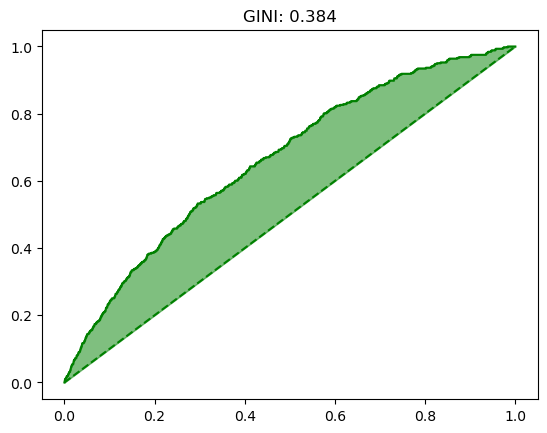

In [193]:
gini_curve(cat_model, X_test, y_test)

In [194]:
def plot_default_histogram(df_b):
    default_scores = df_b[df_b['def'] == 1]['proba']
    non_default_scores = df_b[df_b['def'] == 0]['proba']

    sns.histplot(x=default_scores, color="skyblue", label="Default", kde=True, stat='density')
    sns.histplot(x=non_default_scores, color="red", label="Non_default", kde=True, stat='density')

    plt.legend() 
    plt.show()


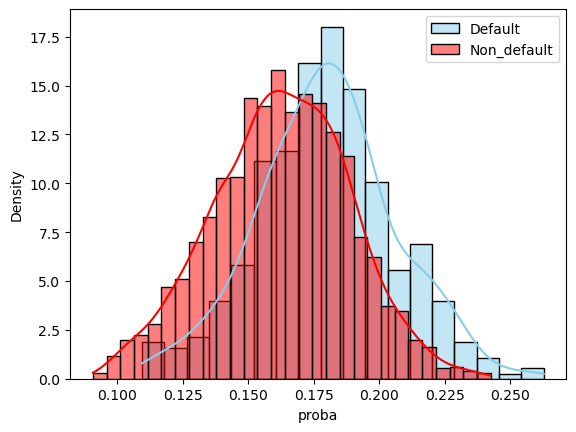

In [195]:
plot_default_histogram(df_b)

#### Тест M2.2: Эффективность ранжирования отдельных факторов

In [196]:
rfc = RandomForestClassifier(n_estimators=2000, max_depth=3, n_jobs=-1, criterion='entropy')
rfc.fit(X_train_rfc, y_train.values)

RandomForestClassifier(criterion='entropy', max_depth=3, n_estimators=2000,
                       n_jobs=-1)

In [197]:
data = zip(rfc.feature_names_in_, rfc.feature_importances_)
sorted_data = sorted(data, key=lambda d: d[1], reverse=True)

In [198]:
sorted_data[:15]

[('loan_amnt', 0.09681385552901514),
 ('term', 0.07755136246483244),
 ('revol_util', 0.06909296680647527),
 ('dti', 0.0648049216680702),
 ('home_ownership_MORTGAGE', 0.05557820601307176),
 ('home_ownership_RENT', 0.05283499627450755),
 ('annual_inc', 0.0504374893232074),
 ('verification_status_Not Verified', 0.04640968444147285),
 ('mort_acc', 0.04150319471328298),
 ('num_actv_bc_tl', 0.03955861218041937),
 ('avg_cur_bal', 0.03820759312120534),
 ('acc_open_past_24mths', 0.03037722262976003),
 ('tot_cur_bal', 0.029684637683866866),
 ('num_tl_op_past_12m', 0.02678409077358451),
 ('total_bc_limit', 0.023888831299613875)]

In [199]:
result_list_train, result_list_test = calculate_feature_importants_4_each_feature(
    sorted_data = sorted_data,
    X_train = X_train_rfc,
    X_test = X_test_rfc,
    y_train = y_train,
    y_test = y_test,
)

100%|██████████| 125/125 [04:44<00:00,  2.27s/it]


In [200]:
def plot_feature_importance(result_list, number_features = 15, ylabel="Gini on train"):
    """
        Отрисовывает признаки и их веса
        input:
            result_list - один из списков, которые вернул calculate_feature_importants_4_each_feature
            number_features - топ признаков для отрисовки
            ylabel - вертикальная подпись
        output:
            Ничего. Рисует график.
        
    """
    x = np.array(result_list[:number_features])[:,0]
    y = [float(i) for i in np.array(result_list[:number_features])[:,2]]
    
    sns.set_theme(style="white", context="talk")

    # Set up the matplotlib figure
    f, (ax1) = plt.subplots(1, 1, figsize=(15, 5), sharex=True)

    # Generate some sequential data
    sns.barplot(
        x=x,
        y=y,
        palette="rocket",
        ax=ax1
    )
    ax1.axhline(0, color="k", clip_on=False)
    ax1.set_ylabel(ylabel)

    # Finalize the plot
    sns.despine(bottom=True)
    plt.setp(f.axes, yticks=[])
    plt.tight_layout(h_pad=2)
    plt.xticks(rotation=75)
    plt.show()
    

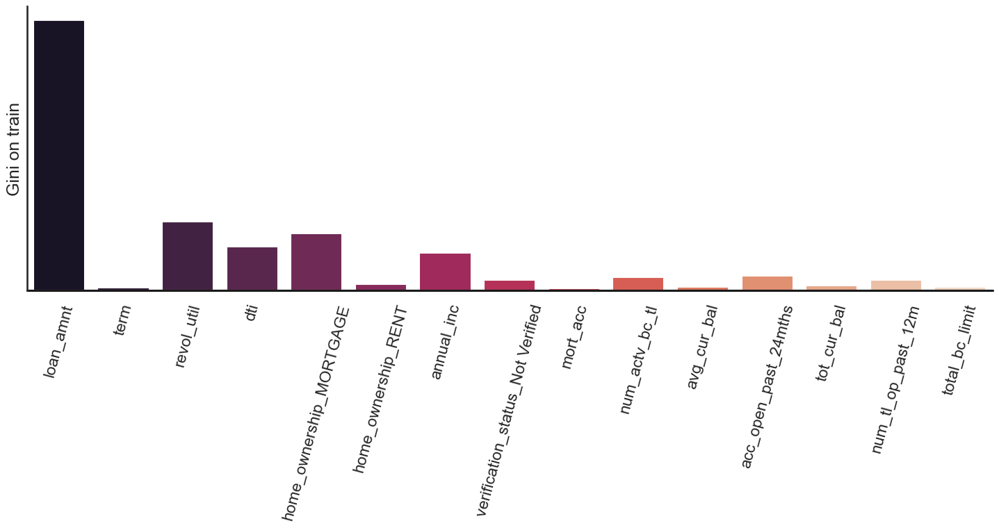

In [201]:
plot_feature_importance(result_list_train, number_features = 15)

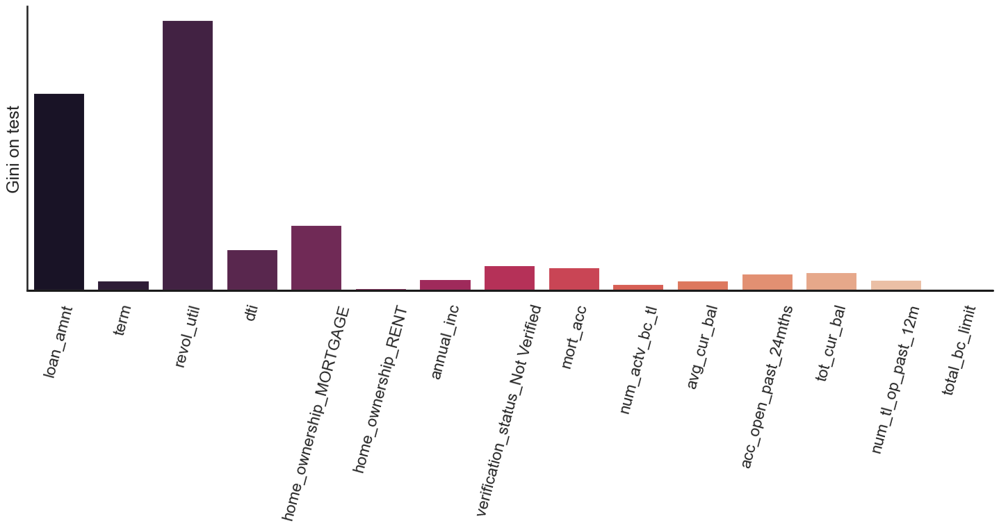

In [202]:
plot_feature_importance(result_list_test, number_features = 15, ylabel = 'Gini on test')

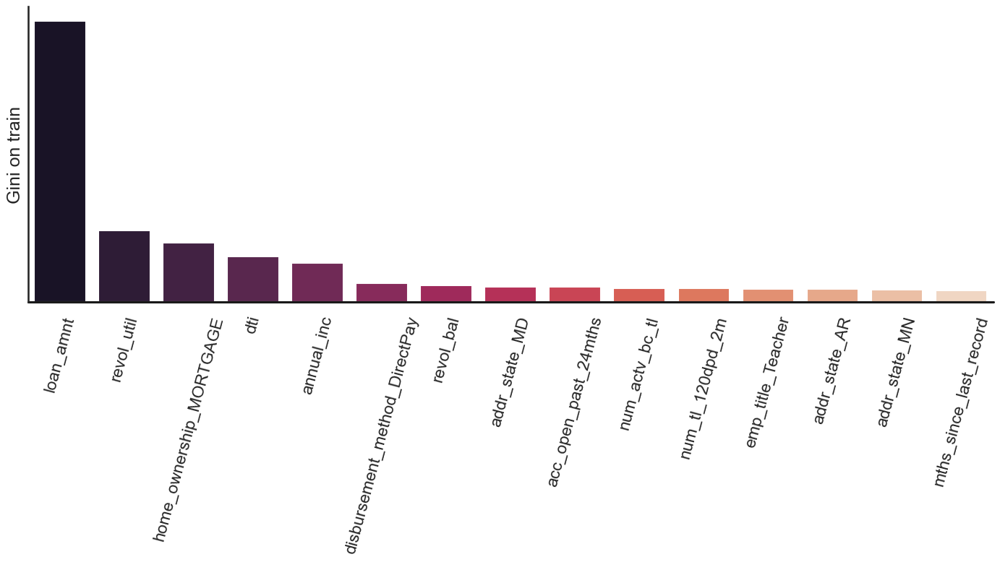

In [203]:
plot_feature_importance(
    sorted(result_list_train, key=lambda d: d[2], reverse=True),
    number_features = 15,
    ylabel = 'Gini on train'
)

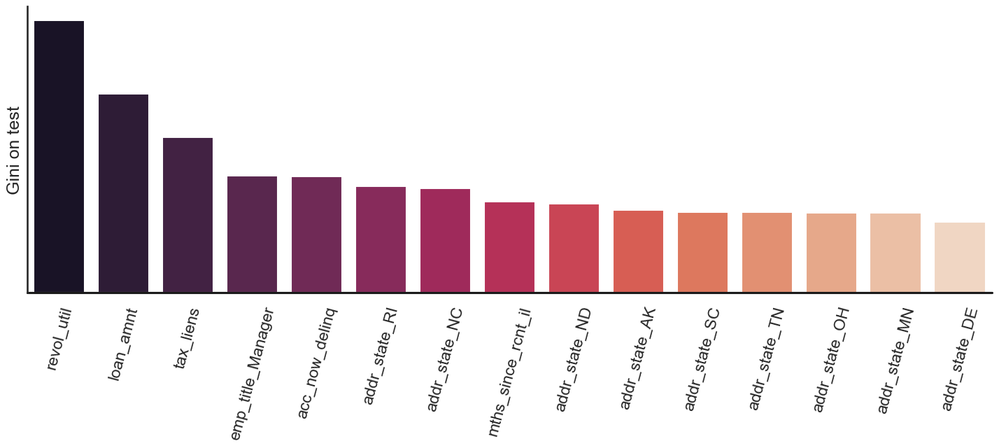

In [204]:
plot_feature_importance(
    sorted(result_list_test, key=lambda d: d[2], reverse=True),
    number_features = 15,
    ylabel = 'Gini on test'
)

#### Тест M2.5: Анализ вкладов факторов в формирование Джини модели

In [205]:
def plot_gini_waterfall(result_list, from_number_features = 0, to_number_features = 10, title = "Инкрементальный прирост Джини при последовательном добавлении факторов в модель"):
    """
        Отрисовывает WaterFall по признакам и их весам
        input:
            result_list - один из списков, которые вернул calculate_feature_importants_4_each_feature
            number_features - топ признаков для отрисовки
            ylabel - вертикальная подпись
        output:
            Ничего. Рисует график.
            
    """
    fig = go.Figure(go.Waterfall(
        name = "Gini",
        orientation = "v",
        measure = ["relative"]*10,
        x = np.array(result_list)[from_number_features:to_number_features, 0], #["Sales", "Consulting", "Net revenue", "Purchases", "Other expenses", "Profit before tax"],
        textposition = "outside",
        text = [i[:5] for i in np.array(result_list)[from_number_features:to_number_features, 2]], #["+60", "+80", "", "-40", "-20", "Total"],
        y = [float(i) for i in np.array(result_list)[from_number_features:to_number_features, 2]],#[60, 80, 20, -40, -20, 20],
        connector = {"line":{"color":"rgb(63, 63, 63)"}},
    ))

    fig.update_layout(
            title = title,
            showlegend = True
    )

    fig.show()


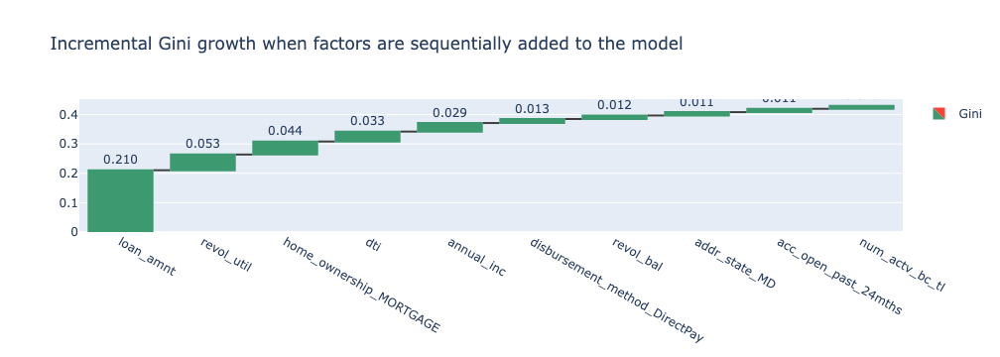

In [206]:
plot_gini_waterfall(
    result_list = sorted(result_list_train, key=lambda d: d[2], reverse=True),
    to_number_features = 10,
    title = "Incremental Gini growth when factors are sequentially added to the model"
)

#### Тест M3: Feature influence

In [207]:
def plot_features_target_dynamic(list_num_features):
    """
        Динамик изменения таргета в бачах
        input:
            list_num_features - один из списков, которые вернул calculate_feature_importants_4_each_feature
        output:
            Ничего. Рисует график.

    """
    for feat_name, _, _, _  in tqdm.tqdm(list_num_features):
        cuts_train = pd.cut(
            X_train_rfc[feat_name],
            bins = pd.interval_range(start=X_train_rfc[feat_name].min(), end= X_train_rfc[feat_name].max()+1, periods=10, closed = 'left')
        )
        cuts_test = pd.cut(
            X_test_rfc[feat_name],
            bins = pd.interval_range(start=X_train_rfc[feat_name].min(), end= X_train_rfc[feat_name].max()+1, periods=10, closed = 'left')
        )

        rfc = RandomForestClassifier(n_estimators=300, criterion='gini', max_depth=3, n_jobs=-1)
        rfc.fit(X_train_rfc[[feat_name]], y_train.values)

        roc_auc_test_train = np.abs(roc_auc_score(
            y_train,
            rfc.predict_proba(X_train[[feat_name]])[:, 1]
        ))
        gini_train = 2*roc_auc_test_train - 1

        roc_auc_test_test = np.abs(roc_auc_score(
            y_test,
            rfc.predict_proba(X_test_rfc[[feat_name]])[:, 1]
        ))
        gini_test = 2*roc_auc_test - 1

        df_cuts_train = pd.DataFrame(
            zip(cuts_train.values, rfc.predict_proba(X_train[[feat_name]])[:, 1]),
            columns=['bin','proba']
        )
        df_cuts_test = pd.DataFrame(
            zip(cuts_test,rfc.predict_proba(X_test_rfc[[feat_name]])[:, 1]),
            columns=['bin','proba']
        )
        
        df_cuts_train_gb = df_cuts_train.groupby(['bin'])['proba'].agg(['mean', 'count'])
        df_cuts_test_gb = df_cuts_test.groupby(['bin'])['proba'].agg(['mean', 'count'])
        
        # ---------------------------------------------------------------------------------------- PLOT ------------------------------------------------------------------------------
        fig = make_subplots(rows=1, cols=2)
        fig.add_trace(
            go.Histogram(
                histfunc="count",
                y=[float(i) for i in df_cuts_train['proba']],
                x=[str(i) for i in df_cuts_train['bin'].values],
                name=f"train_count",
                legendgrouptitle_text=f"Feature name: {feat_name}"
            ),
            row=1, col=1
        )

        fig.add_trace(
            go.Histogram(
                histfunc="count",
                y=[float(i) for i in df_cuts_test['proba']],
                x=[str(i) for i in df_cuts_test['bin'].values],
                name="test_count"
            ),
            row=1, col=1
        )
        
        fig.update_xaxes(categoryorder='total ascending')

        fig.add_trace(
            go.Scatter(
                y=[float(i) for i in df_cuts_train_gb['mean'].values],
                x=[str(i) for i in df_cuts_train_gb.index],
                name="scatter_train_mean",
            ),
            row=1, col=2
        )

        fig.add_trace(
            go.Scatter(
                y=[float(i) for i in df_cuts_test_gb['mean'].values],
                x=[str(i) for i in df_cuts_test_gb.index],
                name="scatter_test_mean",
                opacity=0.5
            ),
            row=1, col=2
        )

        fig.update_xaxes(categoryorder='array', categoryarray= [str(i) for i in df_cuts_train_gb.index])

        fig.show()
        # --------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


  0%|          | 0/22 [00:00<?, ?it/s]

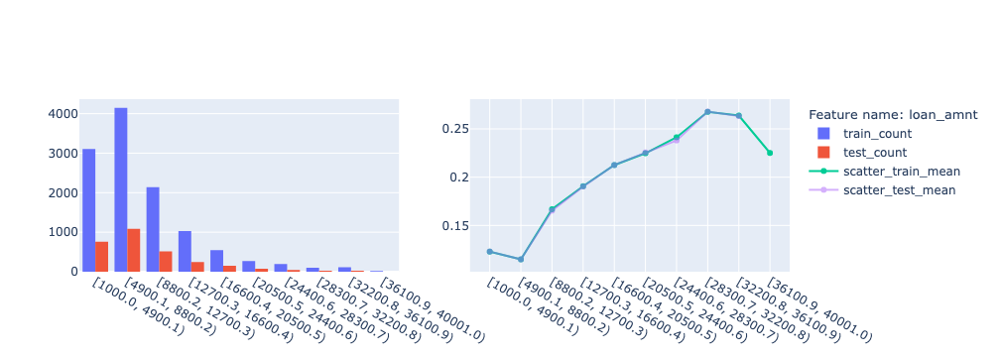

  5%|▍         | 1/22 [00:04<01:33,  4.47s/it]

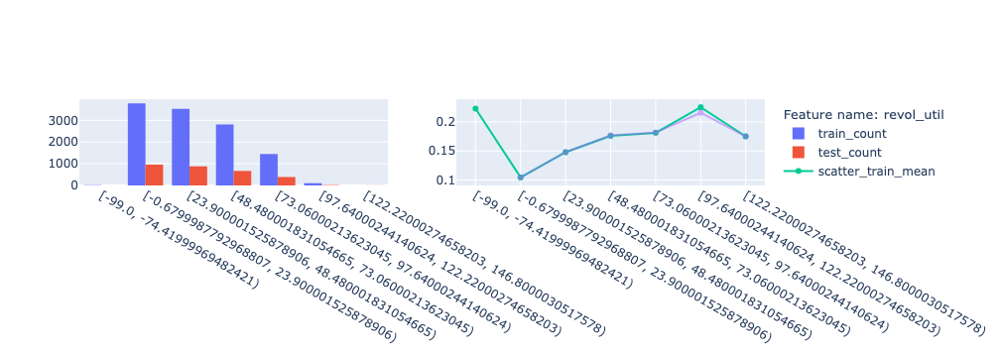

  9%|▉         | 2/22 [00:08<01:21,  4.09s/it]

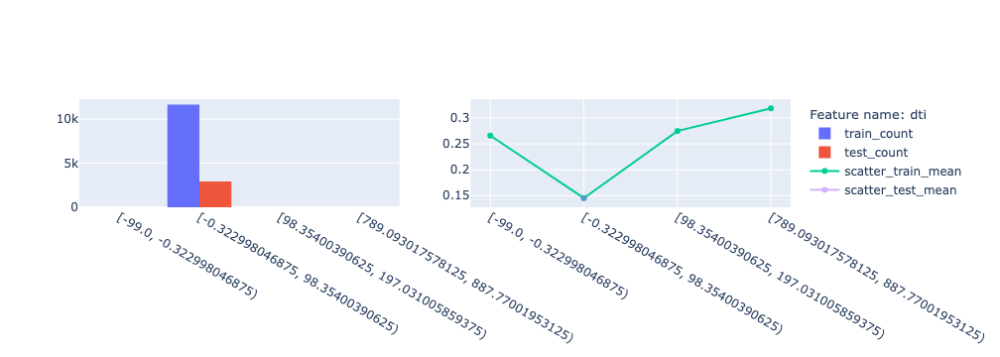

 14%|█▎        | 3/22 [00:11<01:10,  3.73s/it]

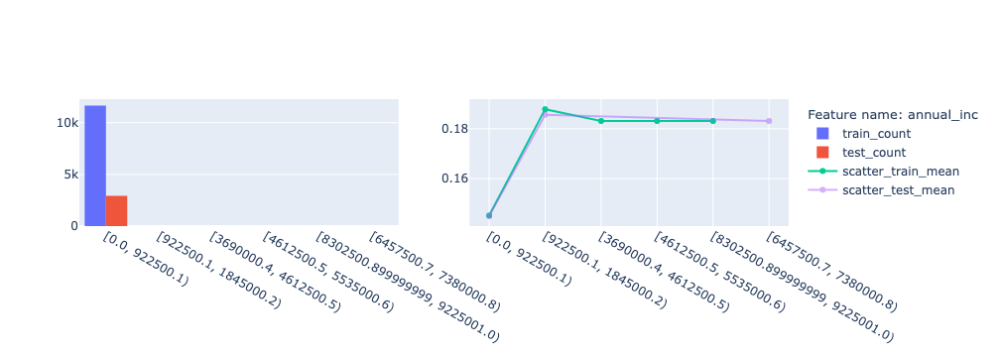

 18%|█▊        | 4/22 [00:14<01:00,  3.36s/it]

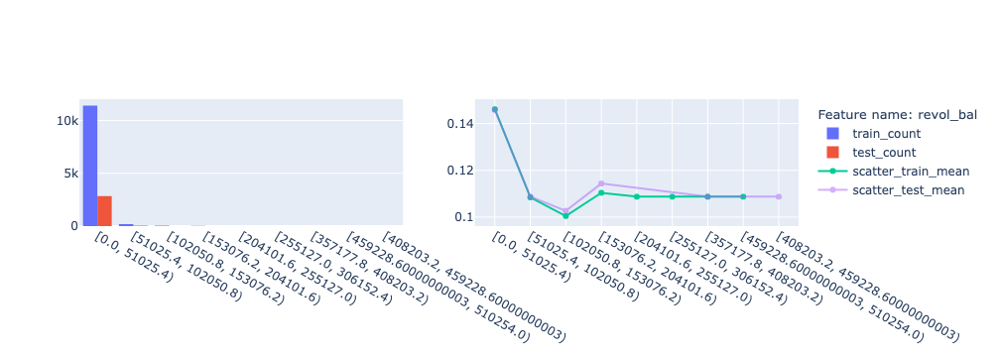

 23%|██▎       | 5/22 [00:17<00:56,  3.32s/it]

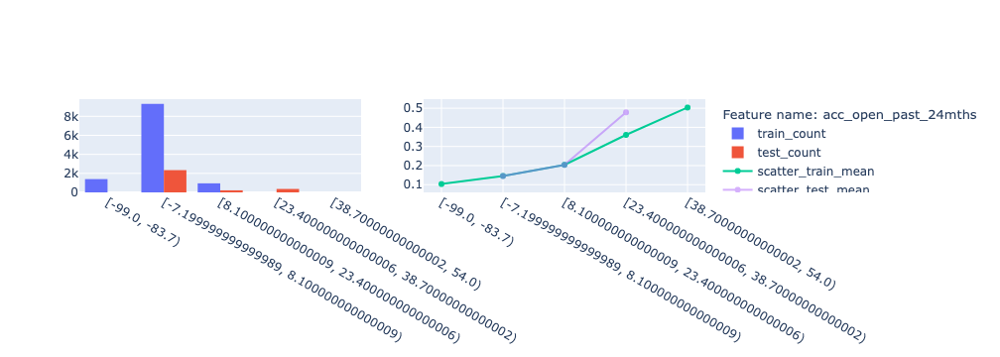

 27%|██▋       | 6/22 [00:20<00:49,  3.10s/it]

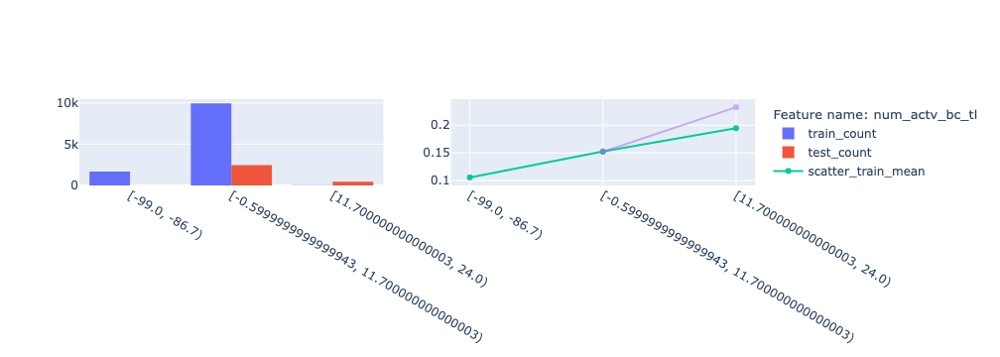

 32%|███▏      | 7/22 [00:22<00:43,  2.88s/it]

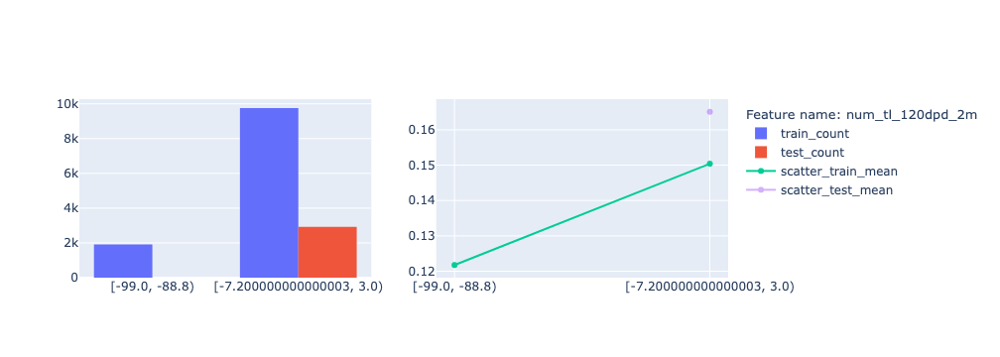

 36%|███▋      | 8/22 [00:25<00:38,  2.73s/it]

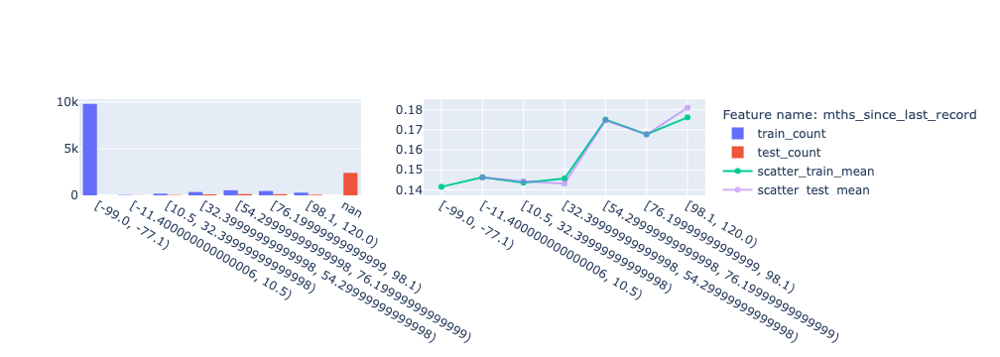

 41%|████      | 9/22 [00:27<00:33,  2.57s/it]

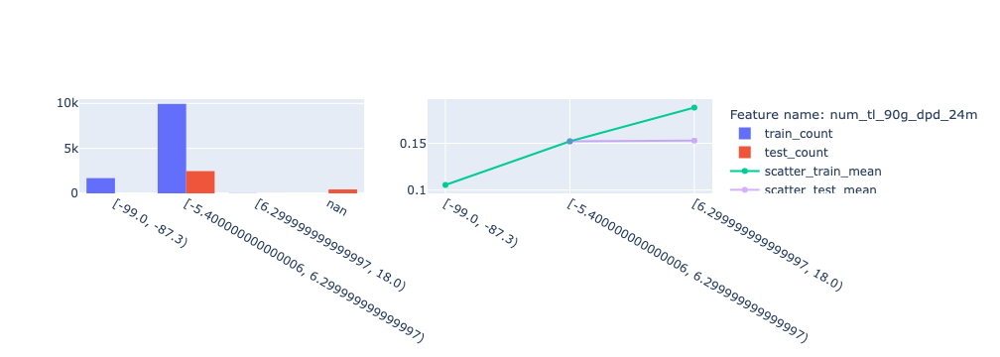

 45%|████▌     | 10/22 [00:29<00:30,  2.58s/it]

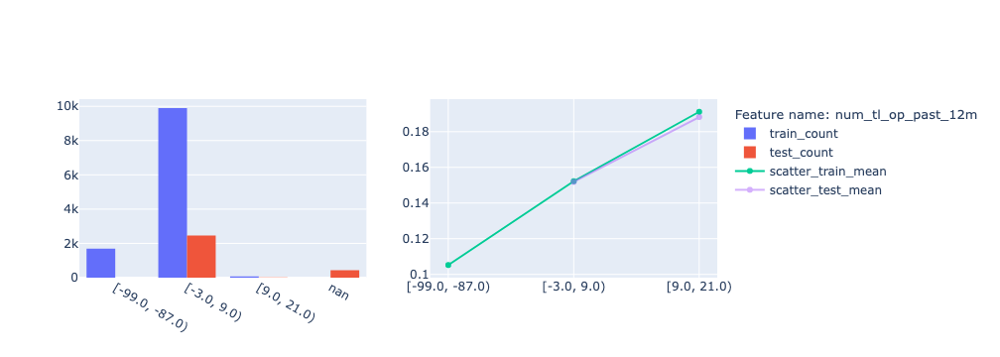

 50%|█████     | 11/22 [00:32<00:27,  2.48s/it]

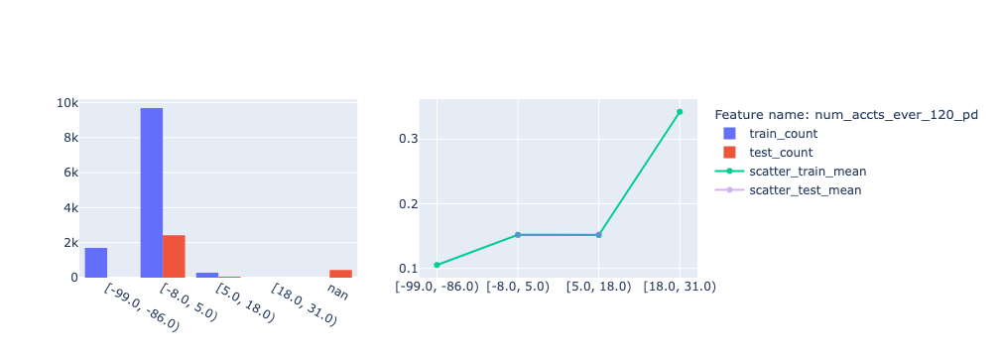

 55%|█████▍    | 12/22 [00:34<00:23,  2.39s/it]

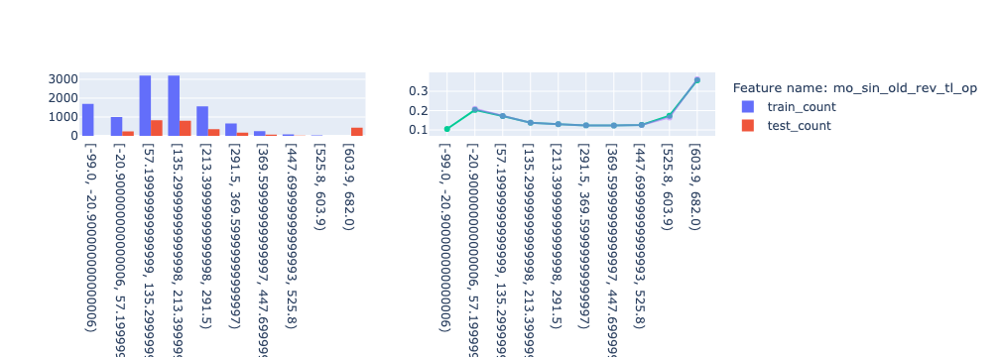

 59%|█████▉    | 13/22 [00:37<00:22,  2.49s/it]

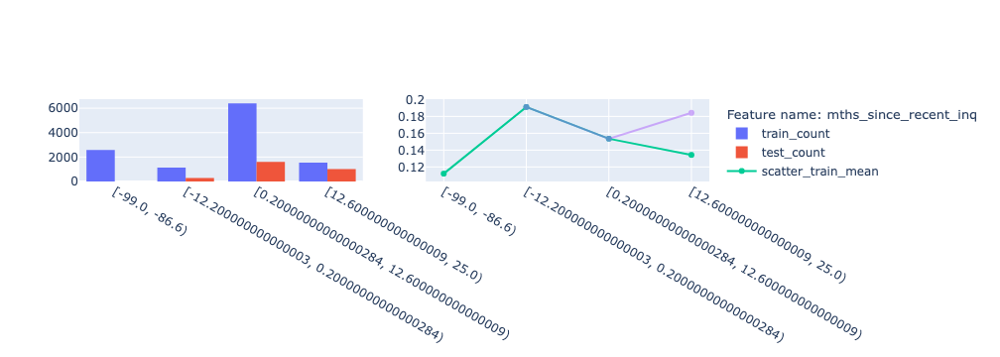

 64%|██████▎   | 14/22 [00:39<00:20,  2.53s/it]

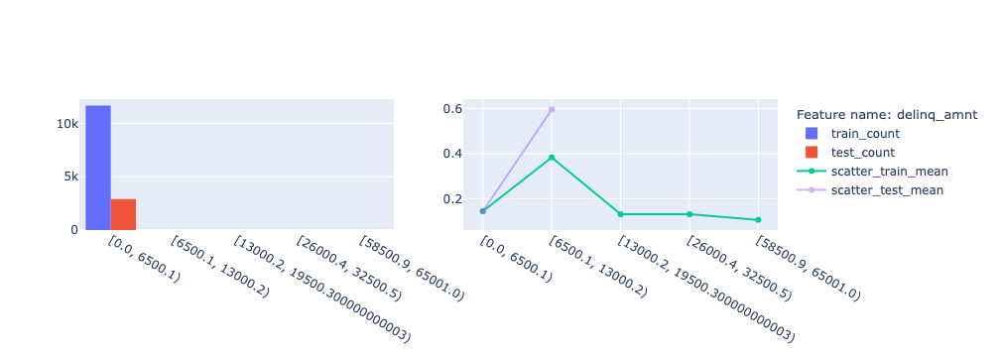

 68%|██████▊   | 15/22 [00:42<00:17,  2.52s/it]

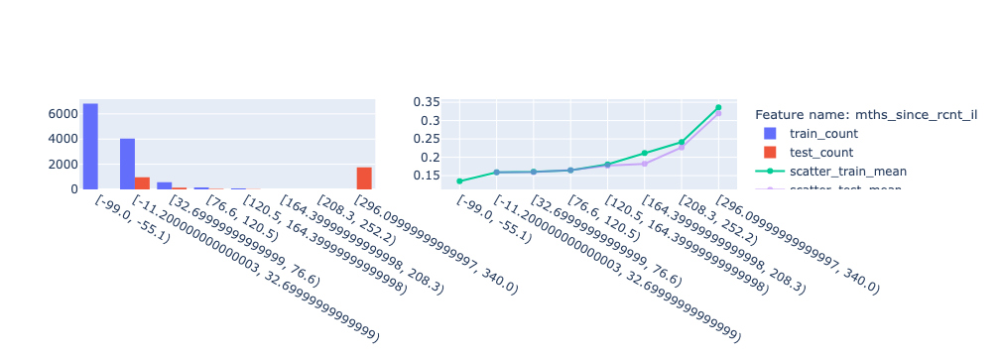

 73%|███████▎  | 16/22 [00:44<00:14,  2.48s/it]

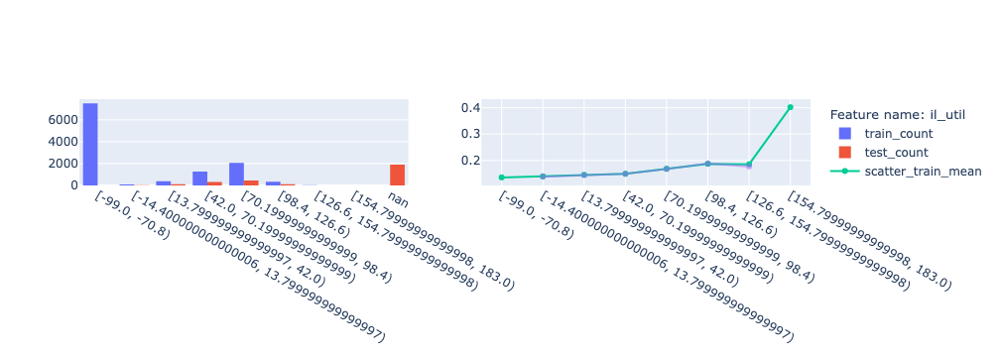

 77%|███████▋  | 17/22 [00:47<00:12,  2.58s/it]

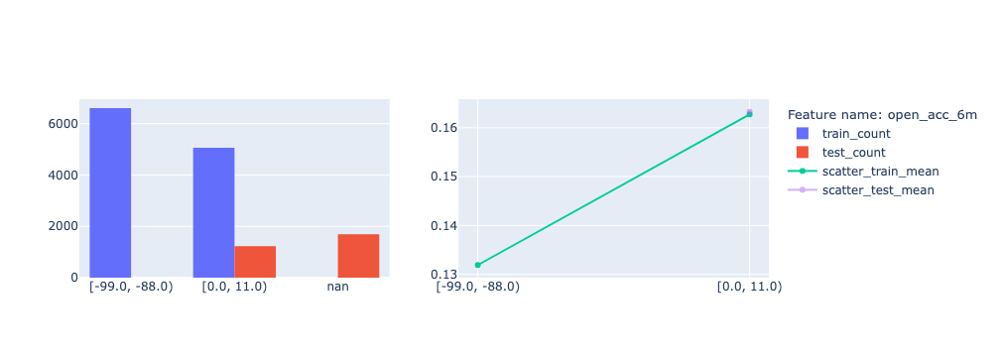

 82%|████████▏ | 18/22 [00:49<00:09,  2.47s/it]

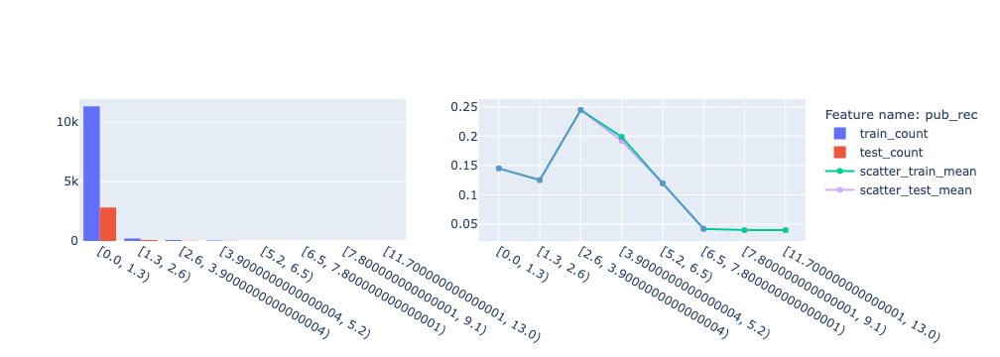

 86%|████████▋ | 19/22 [00:51<00:07,  2.36s/it]

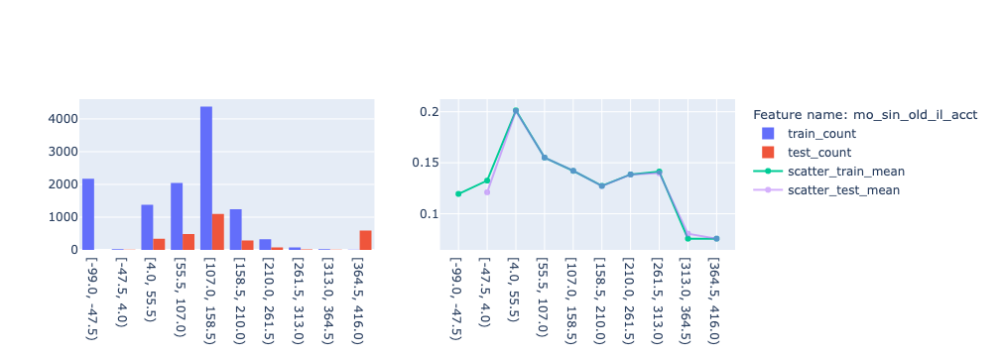

 91%|█████████ | 20/22 [00:54<00:05,  2.55s/it]

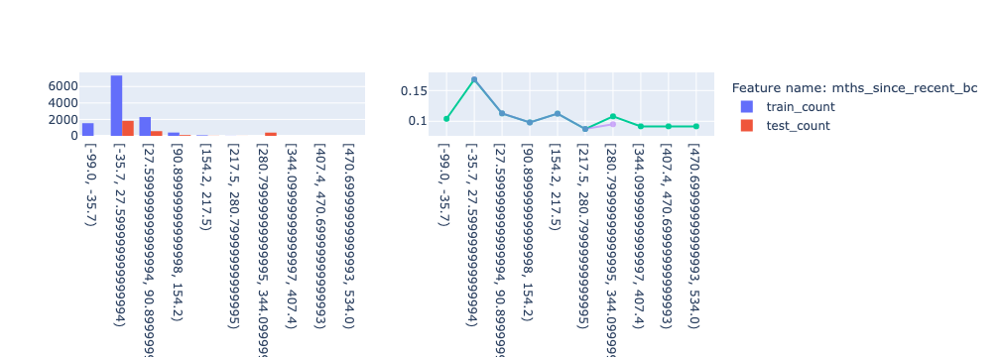

 95%|█████████▌| 21/22 [00:57<00:02,  2.50s/it]

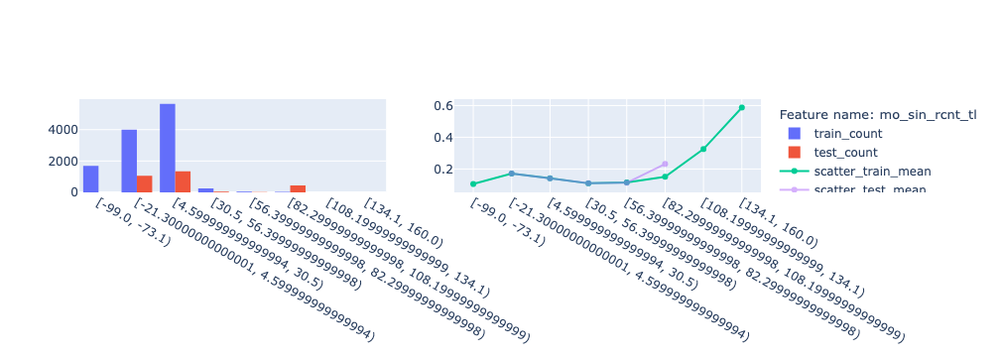

100%|██████████| 22/22 [00:59<00:00,  2.71s/it]


In [208]:
FEATURES_NUM = df_b.select_dtypes('number').columns.to_list()

plot_features_target_dynamic(
    [i for i in np.array(sorted(result_list_train, key=lambda d: d[2], reverse=True))[:50] if i[0] in FEATURES_NUM]
)

#### Confidence interval

In [209]:
def gini_confidence_interval(y_true, y_pred, alpha=0.05, n_bootstrap=1000):
    """
        Функция для расчета доверительного интервала для критерия Джини с помощью бутстрэп-метода.
        input:
            y_true - массив истинных значений целевой переменной
            y_pred - массив прогнозных значений целевой переменной
            alpha - уровень значимости для определения доверительного интервала (по умолчанию 0.05)
            n_bootstrap - количество выборок, которые необходимо сгенерировать для бутстрэп-метода (по умолчанию 1000)
        output:
            Доверительный интервал для критерия Джини в формате (lower_bound, upper_bound).

    """
    y_true = y_true.reset_index(drop=True)
    # Рассчитываем оценку Джини для исходной выборки
    gini = 2 * roc_auc_score(y_true, y_pred) - 1

    # Генерируем n_bootstrap выборок с повторением из исходной выборки
    bootstrap_scores = []
    for i in tqdm.tqdm(range(n_bootstrap)):
        sample_idx = resample(range(len(y_true)), replace=True)
        sample_true = y_true[sample_idx]
        sample_pred = y_pred[sample_idx]
        bootstrap_scores.append(2 * roc_auc_score(sample_true, sample_pred) - 1)

    # Вычисляем доверительный интервал
    lower_bound = np.percentile(bootstrap_scores, (alpha/2) * 100)
    upper_bound = np.percentile(bootstrap_scores, (1 - alpha/2) * 100)

    return (lower_bound, upper_bound)

In [210]:
roc_auc_train = roc_auc_score(
    y_train,
    clf.predict_proba(X_train_rfc)[:,1]
)
gini_train = 2*roc_auc_train-1
gini_CI_train = gini_confidence_interval(y_train, clf.predict_proba(X_train_rfc)[:,1])

roc_auc_test = roc_auc_score(
    y_test,
    clf.predict_proba(X_test_rfc)[:,1]
)
gini_test = 2*roc_auc_test-1
gini_CI_test = gini_confidence_interval(y_test, clf.predict_proba(X_test_rfc)[:,1])

100%|██████████| 1000/1000 [00:04<00:00, 214.16it/s]


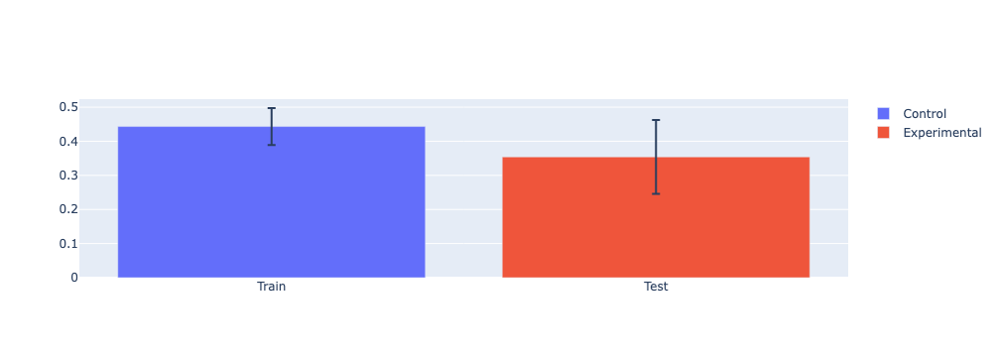

In [211]:
fig = go.Figure()
fig.add_trace(go.Bar(
    name='Control',
    x=['Train'], y=[gini_train],
    error_y=dict(type='data', array=[gini_CI_train[1] - gini_CI_train[0]])
))
fig.add_trace(go.Bar(
    name='Experimental',
    x=['Test'], y=[gini_test],
    error_y=dict(type='data', array=[gini_CI_test[1] - gini_CI_test[0]])
))

fig.update_layout(barmode='group')
fig.show()